<span style="font-family: Arial; font-weight:bold;font-size:1.5em;color:#00b3e5;">Contents: Featurisation and Model Tuning Project

# Solution

- **DOMAIN:** Semiconductor manufacturing process
- **CONTEXT:** A complex modern semiconductor manufacturing process is normally under constant surveillance via the monitoring of signals/variables collected from sensors and or process measurement points. However, not all of these signals are equally valuable in a specific monitoring system. The measured signals contain a combination of useful information, irrelevant information as well as noise. Engineers typically have a much larger number of signals than are actually required. If we consider each type of signal as a feature, then feature selection may be applied to identify the most relevant signals. The Process Engineers may then use these signals to determine key factors contributing to yield excursions downstream in the process. This will enable an increase in process throughput, decreased time to learning and reduce the per unit production costs. These signals can be used as features to predict the yield type. And by analysing and trying out different combinations of features, essential signals that are impacting the yield type can be identified.
- **DATA DESCRIPTION:** signal-data.csv : (1567, 592); The data consists of 1567 datapoints each with 591 features. The dataset presented in this case represents a selection of such features where each example represents a single production entity with associated measured features and the labels represent a simple pass/fail yield for in house line testing. Target column “ –1” corresponds to a pass and “1” corresponds to a fail and the data time stamp is for that specific test point.
- **PROJECT OBJECTIVE:** We will build a classifier to predict the Pass/Fail yield of a particular process entity and analyse whether all the features are required to build the model or not.

In [1]:
# Import all the relevant libraries needed to complete the analysis, visualization, modeling and presentation
import pandas as pd
import numpy as np
import os

import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
sns.set_style('darkgrid')
%matplotlib inline

from scipy import stats
from scipy.stats import zscore

from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import RobustScaler
from sklearn import model_selection
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from sklearn.model_selection import RandomizedSearchCV, StratifiedKFold, KFold
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report 
from sklearn.metrics import ConfusionMatrixDisplay, precision_score, recall_score 
from sklearn.metrics import precision_recall_curve, roc_curve, auc, roc_auc_score
from sklearn.metrics import plot_precision_recall_curve, average_precision_score
from sklearn.metrics import f1_score, plot_roc_curve 

from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LinearRegression, LogisticRegression, RidgeClassifier
from sklearn.naive_bayes import GaussianNB, BernoulliNB
from sklearn.svm import SVC

from sklearn.decomposition import PCA
from scipy.cluster.hierarchy import dendrogram, linkage
from scipy.cluster.hierarchy import fcluster
from sklearn.cluster import KMeans 
from sklearn.metrics import silhouette_samples, silhouette_score
from kmodes.kprototypes import KPrototypes

import xgboost as xgb
from xgboost import plot_importance
from catboost import CatBoostClassifier
from lightgbm import LGBMClassifier

from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import VotingClassifier

from imblearn.over_sampling import RandomOverSampler
from imblearn.over_sampling import SMOTENC, SMOTE, ADASYN
from imblearn.under_sampling import RandomUnderSampler

import warnings
warnings.filterwarnings("ignore")

# pd.set_option('display.max_columns', None)
# pd.set_option('display.max_rows', None)

C:\Anaconda\lib\site-packages\xgboost\compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index


## 1. Import and understand the data.

### 1A. Import ‘signal-data.csv’ as DataFrame.

In [2]:
# CSV File 1
dfa=pd.read_csv('signal-data.csv')

In [3]:
dfa.info()
dfa.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1567 entries, 0 to 1566
Columns: 592 entries, Time to Pass/Fail
dtypes: float64(590), int64(1), object(1)
memory usage: 7.1+ MB


,Time,0,1,2,3,4,5,6,7,8,...,581,582,583,584,585,586,587,588,589,Pass/Fail
0,2008-07-19 11:55:00,3030.93,2564.00,2187.7333,1411.1265,1.3602,100.0,97.6133,0.1242,1.5005,...,NaN,0.5005,0.0118,0.0035,2.3630,NaN,NaN,NaN,NaN,-1
1,2008-07-19 12:32:00,3095.78,2465.14,2230.4222,1463.6606,0.8294,100.0,102.3433,0.1247,1.4966,...,208.2045,0.5019,0.0223,0.0055,4.4447,0.0096,0.0201,0.0060,208.2045,-1
2,2008-07-19 13:17:00,2932.61,2559.94,2186.4111,1698.0172,1.5102,100.0,95.4878,0.1241,1.4436,...,82.8602,0.4958,0.0157,0.0039,3.1745,0.0584,0.0484,0.0148,82.8602,1
3,2008-07-19 14:43:00,2988.72,2479.90,2199.0333,909.7926,1.3204,100.0,104.2367,0.1217,1.4882,...,73.8432,0.4990,0.0103,0.0025,2.0544,0.0202,0.0149,0.0044,73.8432,-1
4,2008-07-19 15:22:00,3032.24,2502.87,2233.3667,1326.5200,1.5334,100.0,100.3967,0.1235,1.5031,...,NaN,0.4800,0.4766,0.1045,99.3032,0.0202,0.0149,0.0044,73.8432,-1


### 1B. Print 5 point summary and share at least 2 observations.

In [4]:
# Describe function generates descriptive statistics that summarize the central tendency, 
# dispersion and shape of a dataset’s distribution, excluding NaN values.

# This method tells us a lot of things about a dataset. One important thing is that 
# the describe() method deals only with numeric values. It doesn't work with any 
# categorical values. So if there are any categorical values in a column the describe() 
# method will ignore it and display summary for the other columns.
dfa.describe().T

,count,mean,std,min,25%,50%,75%,max
0,1561.0,3014.452896,73.621787,2743.2400,2966.260000,3011.4900,3056.6500,3356.3500
1,1560.0,2495.850231,80.407705,2158.7500,2452.247500,2499.4050,2538.8225,2846.4400
2,1553.0,2200.547318,29.513152,2060.6600,2181.044400,2201.0667,2218.0555,2315.2667
3,1553.0,1396.376627,441.691640,0.0000,1081.875800,1285.2144,1591.2235,3715.0417
4,1553.0,4.197013,56.355540,0.6815,1.017700,1.3168,1.5257,1114.5366
...,...,...,...,...,...,...,...,...
586,1566.0,0.021458,0.012358,-0.0169,0.013425,0.0205,0.0276,0.1028
587,1566.0,0.016475,0.008808,0.0032,0.010600,0.0148,0.0203,0.0799
588,1566.0,0.005283,0.002867,0.0010,0.003300,0.0046,0.0064,0.0286
589,1566.0,99.670066,93.891919,0.0000,44.368600,71.9005,114.7497,737.3048


**Observations:**

- Feature 0:
 - Mean and Median are nearly equal. Distribution might be normal.
 - 75 % of values are less than 3056, and maximum value is 3356.
- Feature 589:
 - Mean and median are not equal. Skewness is expected.
 - Range of values is large.
 - Distribution is not normal because of big SD.

## 2. Data cleansing:

### 2A. Write a for loop which will remove all the features with 20%+ Null values and impute rest with mean of the feature.

In [5]:
# Percentage of missing values

# df.isnull().sum()
# df.isna().sum()

def missing_check(df):
    total = df.isnull().sum().sort_values(ascending=False)   # total number of null values
    percent = (df.isnull().sum()/df.isnull().count()).sort_values(ascending=False)  # percentage of values that are null
    missing_data = pd.concat([total, percent], axis=1, keys=['Total', 'Percent'])  # putting the above two together
    return missing_data # return the dataframe
missing_check(dfa)

,Total,Percent
158,1429,0.911934
292,1429,0.911934
293,1429,0.911934
157,1429,0.911934
85,1341,0.855775
...,...,...
386,0,0.000000
361,0,0.000000
360,0,0.000000
359,0,0.000000


In [6]:
def rmissingvaluecol(dff, threshold):
    l = []
    l = list(dff.drop(dff.loc[:,list((100*(dff.isnull().sum()/len(dff.index)) >= threshold))].columns, 1).columns.values)
    print("# Columns having more than %s percent missing values: "%threshold, (dff.shape[1] - len(l)))
    print("Columns:\n", list(set(list((dff.columns.values))) - set(l)))
    return l


rmissingvaluecol(dfa,20) # Here threshold is 20% which means we are going to drop columns having more than 20% of missing values

# Columns having more than 20 percent missing values:  32
Columns:
 ['157', '580', '382', '245', '110', '385', '220', '345', '492', '247', '72', '346', '293', '358', '85', '158', '73', '579', '244', '581', '516', '246', '519', '384', '111', '578', '109', '292', '383', '518', '517', '112']


['Time',
 '0',
 '1',
 '2',
 '3',
 '4',
 '5',
 '6',
 '7',
 '8',
 '9',
 '10',
 '11',
 '12',
 '13',
 '14',
 '15',
 '16',
 '17',
 '18',
 '19',
 '20',
 '21',
 '22',
 '23',
 '24',
 '25',
 '26',
 '27',
 '28',
 '29',
 '30',
 '31',
 '32',
 '33',
 '34',
 '35',
 '36',
 '37',
 '38',
 '39',
 '40',
 '41',
 '42',
 '43',
 '44',
 '45',
 '46',
 '47',
 '48',
 '49',
 '50',
 '51',
 '52',
 '53',
 '54',
 '55',
 '56',
 '57',
 '58',
 '59',
 '60',
 '61',
 '62',
 '63',
 '64',
 '65',
 '66',
 '67',
 '68',
 '69',
 '70',
 '71',
 '74',
 '75',
 '76',
 '77',
 '78',
 '79',
 '80',
 '81',
 '82',
 '83',
 '84',
 '86',
 '87',
 '88',
 '89',
 '90',
 '91',
 '92',
 '93',
 '94',
 '95',
 '96',
 '97',
 '98',
 '99',
 '100',
 '101',
 '102',
 '103',
 '104',
 '105',
 '106',
 '107',
 '108',
 '113',
 '114',
 '115',
 '116',
 '117',
 '118',
 '119',
 '120',
 '121',
 '122',
 '123',
 '124',
 '125',
 '126',
 '127',
 '128',
 '129',
 '130',
 '131',
 '132',
 '133',
 '134',
 '135',
 '136',
 '137',
 '138',
 '139',
 '140',
 '141',
 '142',
 '143',
 '

In [7]:
l = rmissingvaluecol(dfa, 20)
dfa = dfa[l]

# Columns having more than 20 percent missing values:  32
Columns:
 ['157', '580', '382', '245', '110', '385', '220', '345', '492', '247', '72', '346', '293', '358', '85', '158', '73', '579', '244', '581', '516', '246', '519', '384', '111', '578', '109', '292', '383', '518', '517', '112']


In [8]:
dfa.info()
dfa.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1567 entries, 0 to 1566
Columns: 560 entries, Time to Pass/Fail
dtypes: float64(558), int64(1), object(1)
memory usage: 6.7+ MB


,Time,0,1,2,3,4,5,6,7,8,...,577,582,583,584,585,586,587,588,589,Pass/Fail
0,2008-07-19 11:55:00,3030.93,2564.00,2187.7333,1411.1265,1.3602,100.0,97.6133,0.1242,1.5005,...,14.9509,0.5005,0.0118,0.0035,2.3630,NaN,NaN,NaN,NaN,-1
1,2008-07-19 12:32:00,3095.78,2465.14,2230.4222,1463.6606,0.8294,100.0,102.3433,0.1247,1.4966,...,10.9003,0.5019,0.0223,0.0055,4.4447,0.0096,0.0201,0.0060,208.2045,-1
2,2008-07-19 13:17:00,2932.61,2559.94,2186.4111,1698.0172,1.5102,100.0,95.4878,0.1241,1.4436,...,9.2721,0.4958,0.0157,0.0039,3.1745,0.0584,0.0484,0.0148,82.8602,1
3,2008-07-19 14:43:00,2988.72,2479.90,2199.0333,909.7926,1.3204,100.0,104.2367,0.1217,1.4882,...,8.5831,0.4990,0.0103,0.0025,2.0544,0.0202,0.0149,0.0044,73.8432,-1
4,2008-07-19 15:22:00,3032.24,2502.87,2233.3667,1326.5200,1.5334,100.0,100.3967,0.1235,1.5031,...,10.9698,0.4800,0.4766,0.1045,99.3032,0.0202,0.0149,0.0044,73.8432,-1


In [9]:
dfa.isnull().sum()

Time          0
0             6
1             7
2            14
3            14
             ..
586           1
587           1
588           1
589           1
Pass/Fail     0
Length: 560, dtype: int64

**Absence of a signal is assumed to be no signal in the dataset:**
- So its better to replace the NaN values with zero.
- Replacing NaN values with zero is giving a better performance metrics.

In [10]:
# Replace the NaN/NA with mean, median or zero (considering it as no signal)
# dfa.fillna(dfa.mean(),inplace = True)
dfa.fillna(0,inplace=True)

In [11]:
# Again, checking if there is any NULL values left
dfa.isnull().any().any()

False

### 2B. Identify and drop the features which are having same value for all the rows.

In [12]:
# Drop the columns that have constant signal
cols = dfa.select_dtypes([np.number]).columns
std = dfa[cols].std()
cols_to_drop = std[std==0].index
dfa.drop(cols_to_drop, axis=1,inplace=True)
dfa.head()

,Time,0,1,2,3,4,5,6,7,8,...,577,582,583,584,585,586,587,588,589,Pass/Fail
0,2008-07-19 11:55:00,3030.93,2564.00,2187.7333,1411.1265,1.3602,100.0,97.6133,0.1242,1.5005,...,14.9509,0.5005,0.0118,0.0035,2.3630,0.0000,0.0000,0.0000,0.0000,-1
1,2008-07-19 12:32:00,3095.78,2465.14,2230.4222,1463.6606,0.8294,100.0,102.3433,0.1247,1.4966,...,10.9003,0.5019,0.0223,0.0055,4.4447,0.0096,0.0201,0.0060,208.2045,-1
2,2008-07-19 13:17:00,2932.61,2559.94,2186.4111,1698.0172,1.5102,100.0,95.4878,0.1241,1.4436,...,9.2721,0.4958,0.0157,0.0039,3.1745,0.0584,0.0484,0.0148,82.8602,1
3,2008-07-19 14:43:00,2988.72,2479.90,2199.0333,909.7926,1.3204,100.0,104.2367,0.1217,1.4882,...,8.5831,0.4990,0.0103,0.0025,2.0544,0.0202,0.0149,0.0044,73.8432,-1
4,2008-07-19 15:22:00,3032.24,2502.87,2233.3667,1326.5200,1.5334,100.0,100.3967,0.1235,1.5031,...,10.9698,0.4800,0.4766,0.1045,99.3032,0.0202,0.0149,0.0044,73.8432,-1


In [13]:
dfa.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1567 entries, 0 to 1566
Columns: 448 entries, Time to Pass/Fail
dtypes: float64(446), int64(1), object(1)
memory usage: 5.4+ MB


### 2C. Drop other features if required using relevant functional knowledge. Clearly justify the same.

In [14]:
# Time is the id of the customer with corresponding details. This information may not be requried
# for analysis and modeling as the Time will be all unique values. So we can drop it safely.
dfa.drop(['Time'], axis=1, inplace=True)

In [15]:
# Label encode the target class with 0 and 1
dfa['Pass/Fail']=dfa['Pass/Fail'].replace([-1,1],[0,1])

### 2D. Check for multi-collinearity in the data and take necessary action.

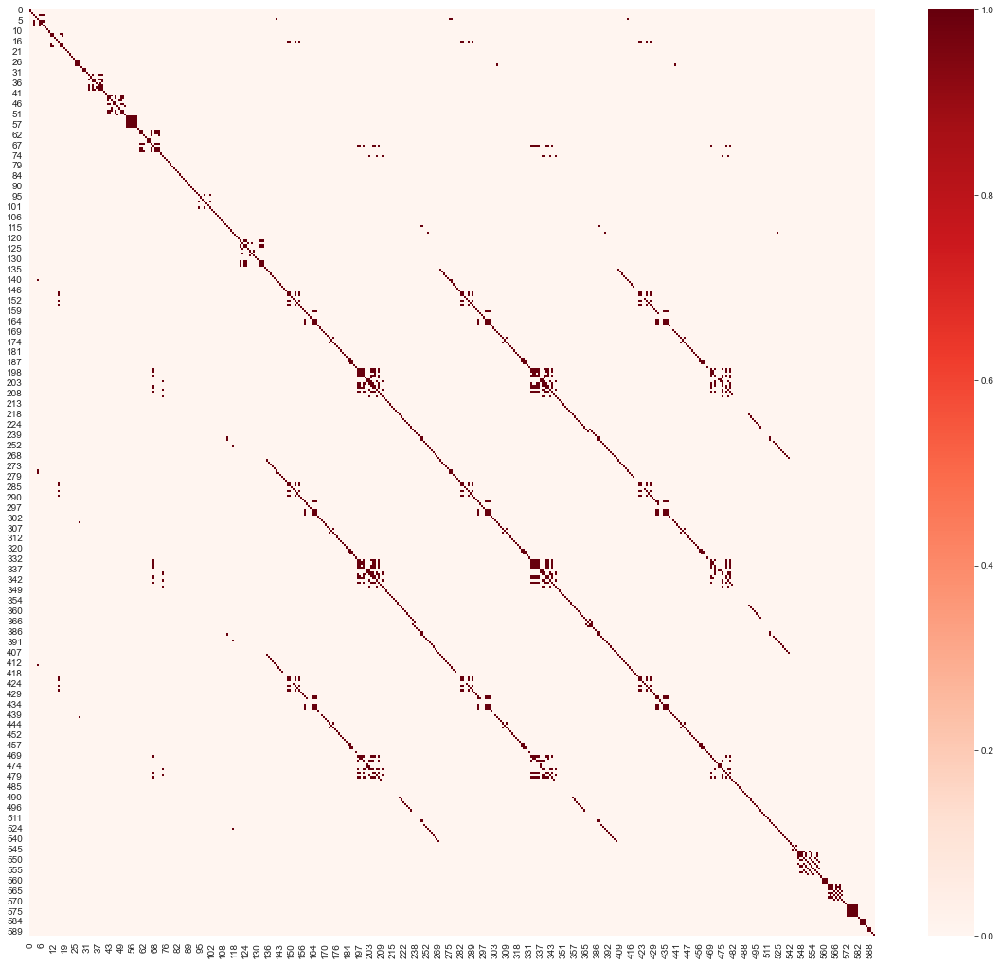

In [16]:
# Check for correlation and consider the features where correlation coeff > 0.7
plt.figure(figsize=(20,18))
corr=dfa.corr()
sns.heatmap(abs(corr>0.7),cmap="Reds");

In [17]:
# Make a copy of the dataset and drop the target class for easy EDA
dfa1=dfa.copy()
dfa1.drop(['Pass/Fail'],axis=1,inplace=True)

In [18]:
# Create correlation matrix
corr_matrix = dfa1.corr().abs()

# Select upper triangle of correlation matrix
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))

# Select features with correlation greater than 0.70
to_drop = [column for column in upper.columns if any(upper[column] > 0.70)]

# Drop features 
dfa1.drop(to_drop, axis=1, inplace=True)

In [19]:
row,column=dfa1.shape
print('After dropping the correlated features the dataset contains:', row, 'rows and', column, 'columns')

After dropping the correlated features the dataset contains: 1567 rows and 184 columns


### 2E. Make all relevant modifications on the data using both functional/logical reasoning/assumptions.

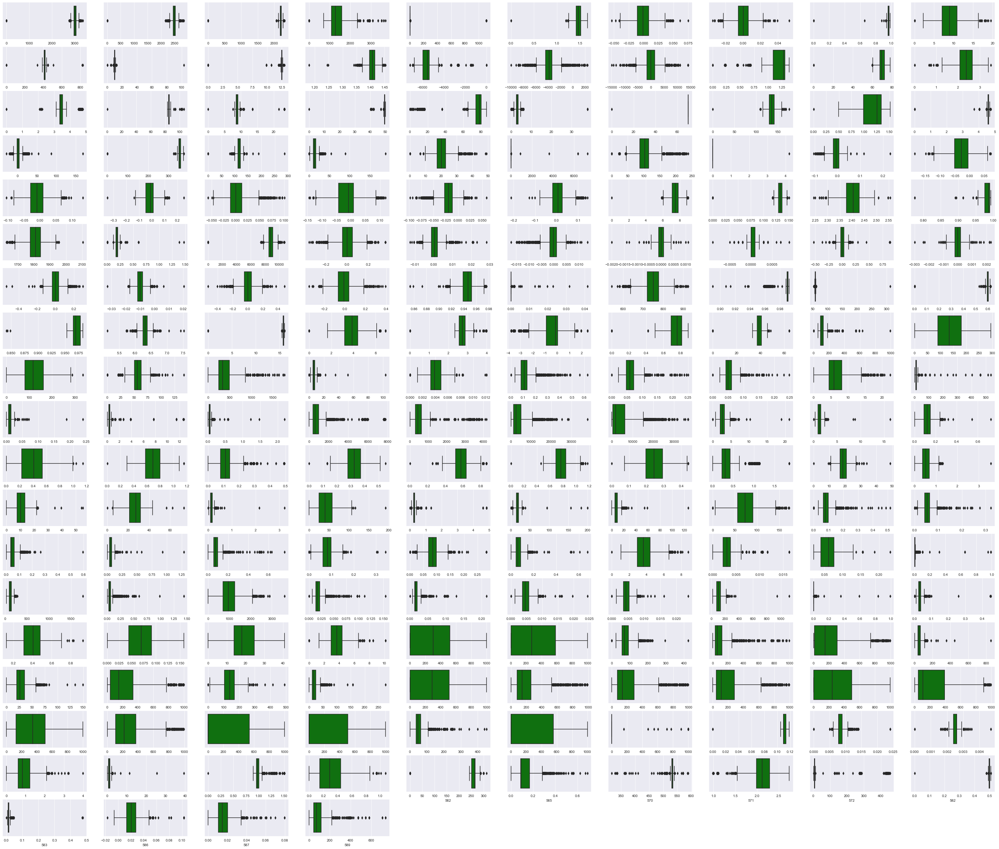

In [20]:
# Use boxplot to check for outliers
plt.figure(figsize=(50, 50))
col = 1
for i in dfa1.columns:
    plt.subplot(22, 10, col)
    sns.boxplot(dfa1[i],color='green')
    col += 1

In [21]:
# Replace the outliers with median
for i in dfa1.columns:
    q1 = dfa1[i].quantile(0.25)
    q3 = dfa1[i].quantile(0.75)
    iqr = q3 - q1
    
    low = q1 - 1.5 * iqr
    high = q3 + 1.5 * iqr
    
    dfa1.loc[(dfa1[i] < low) | (dfa1[i] > high), i] = dfa1[i].median()

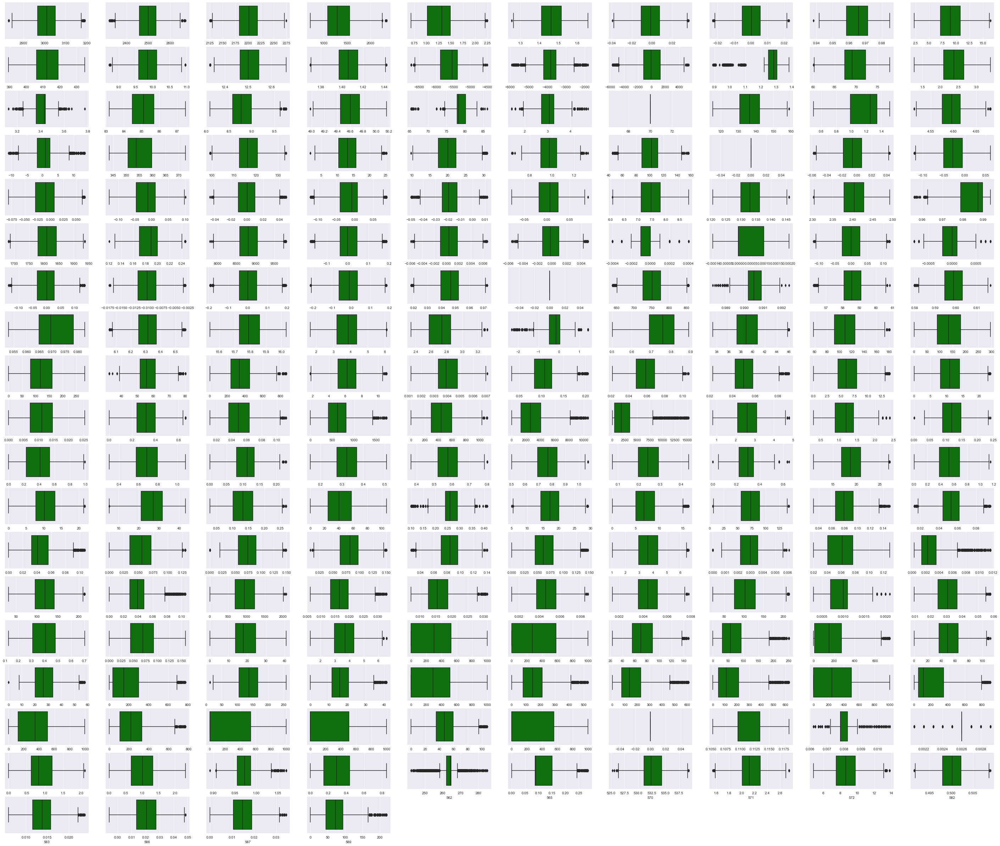

In [22]:
# Situation after removing the outliers with median
plt.figure(figsize=(50, 50))
col = 1
for i in dfa1.columns:
    plt.subplot(22, 10, col)
    sns.boxplot(dfa1[i],color='green')
    col += 1

## 3. Data analysis & visualisation:

### 3A. Perform a detailed univariate Analysis with appropriate detailed comments after each analysis.

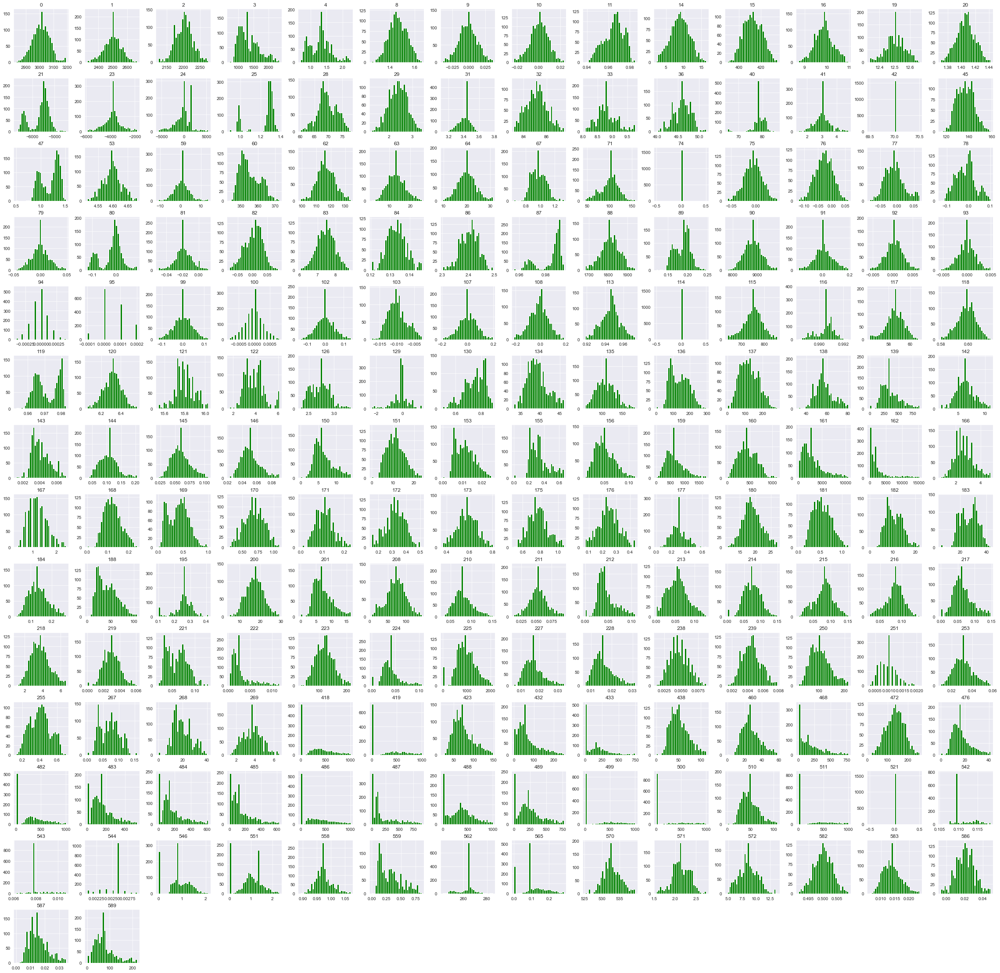

In [23]:
# Check for distribution, skewness
dfa1.hist(bins = 30, figsize = (40, 40), color = 'green')
plt.show()

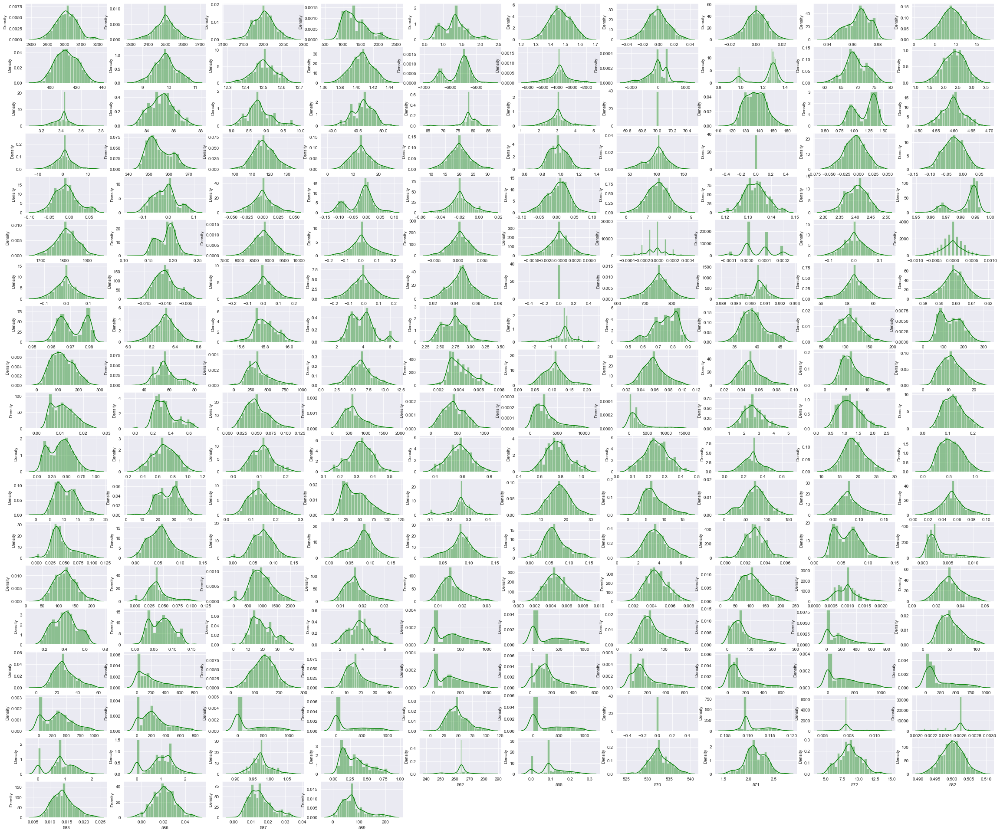

In [24]:
# Density plot to check for the distribution of features
plt.figure(figsize=(40, 40))
col = 1
for i in dfa1.columns:
    plt.subplot(22, 10, col)
    sns.distplot(dfa1[i], color = 'g')
    col += 1 

### 3B. Perform bivariate and multivariate analysis with appropriate detailed comments after each analysis.

In [25]:
# Combine the dataset
y=dfa['Pass/Fail']
dfa1=pd.concat([dfa1,y],axis=1)

In [26]:
dfa1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1567 entries, 0 to 1566
Columns: 185 entries, 0 to Pass/Fail
dtypes: float64(184), int64(1)
memory usage: 2.2 MB


<AxesSubplot:>

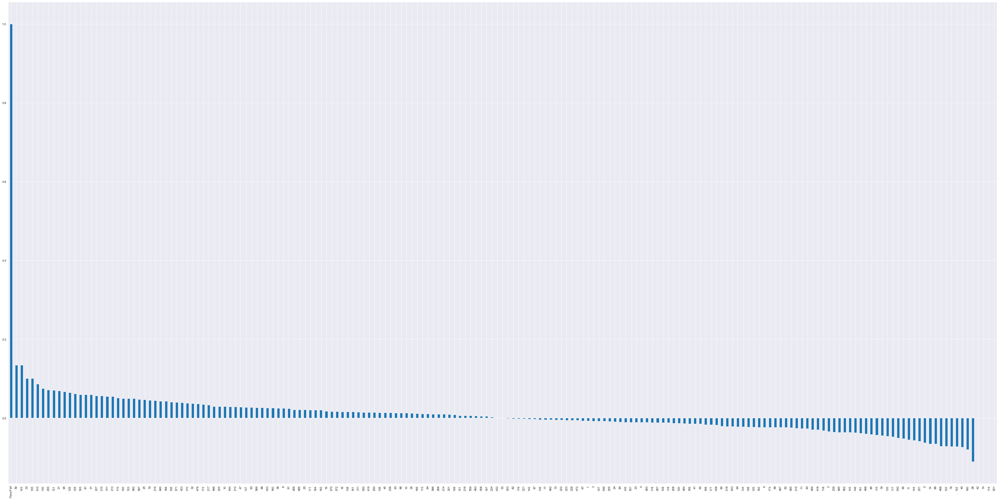

In [27]:
# Correlation of "Pass/Fail" with other features
# Open image in a new tab for details
plt.figure(figsize=(60,30))
dfa1.corr()['Pass/Fail'].sort_values(ascending = False).plot(kind='bar')

In [28]:
# As is evident, we may consider to drop the following features: '224','432','53','253','82','119','221'.
# dfa1.drop(['224','432','53','253','82','119','221'], axis=1, inplace=True)

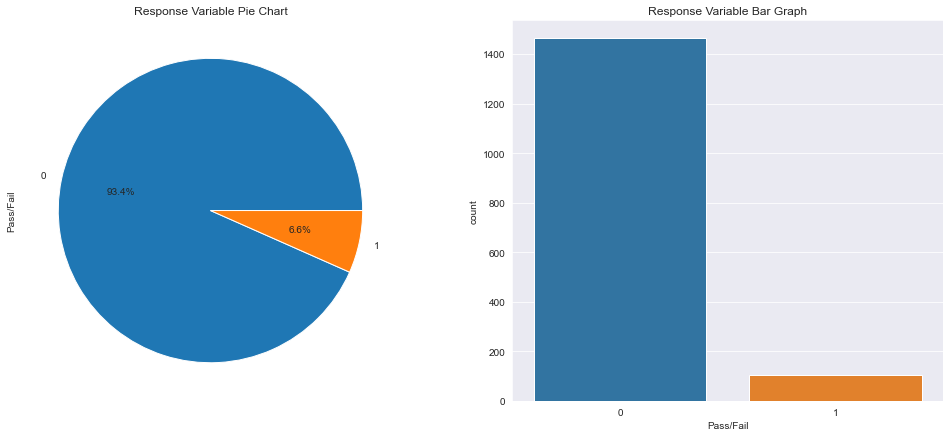

In [29]:
# Understand the target variable and check for imbalanced dataset
f,axes=plt.subplots(1,2,figsize=(17,7))
dfa1['Pass/Fail'].value_counts().plot.pie(autopct='%1.1f%%',ax=axes[0])
sns.countplot('Pass/Fail',data=dfa1,ax=axes[1])
axes[0].set_title('Response Variable Pie Chart')
axes[1].set_title('Response Variable Bar Graph')
plt.show()

In [30]:
# Group datapoints by class
dfa1.groupby(["Pass/Fail"]).count()

,0,1,2,3,4,8,9,10,11,14,...,562,565,570,571,572,582,583,586,587,589
Pass/Fail,,,,,,,,,,,,,,,,,,,,,
0,1463,1463,1463,1463,1463,1463,1463,1463,1463,1463,...,1463,1463,1463,1463,1463,1463,1463,1463,1463,1463
1,104,104,104,104,104,104,104,104,104,104,...,104,104,104,104,104,104,104,104,104,104


**Insights from above graphs:**

- Class 0 has 93.4% of total values followed by Class 1 as 6.6%.
- The above graph shows that the data is biased towards datapoints having class value as 0.
- The number of data points of Class 0 is almost 14 times of Class 1.

**There is big imbalance in the target vector.**

If the imbalanced data is not treated beforehand, then this will degrade the performance of the ML model. Most of the predictions will correspond to the majority class and treat the minority class of features as noise in the data and ignore them. This results in a high bias and low performance of the model.

A widely adopted technique for dealing with highly unbalanced datasets is called re-sampling.

**Two widely used re-sampling methods are:**

- Under-sampling: It is the process where you randomly delete some of the observations from the majority class in order to match the numbers with the minority class.
- Over-sampling: It is the process of generating synthetic data that tries to randomly generate a sample of the attributes from observations in the minority class
- Here we will use oversampling because under-sampling may remove important information from the dataset

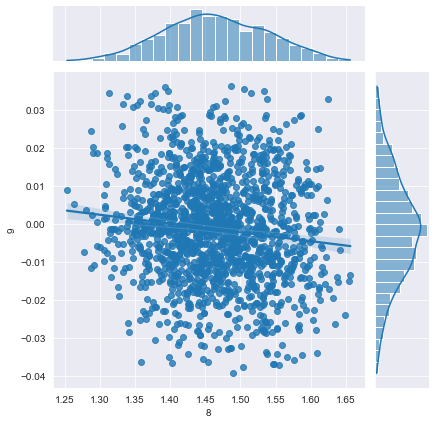

In [31]:
# Visualize a jointplot for ‘8’ and ‘9’ and share insights.
sns.jointplot(data = dfa1, x="8", y="9", kind = "reg")

**Observations:**

- No correlation exists between 8 and 9.
- Data distribution is almost like normal except some skewness.
- Presence of outliers affect the value of regression coefficients.
- Similar graphical observations can be replicated for variables of interest.

In [32]:
# Print the correlation coefficient between every pair of attributes
dfa1.corr()

,0,1,2,3,4,8,9,10,11,14,...,565,570,571,572,582,583,586,587,589,Pass/Fail
0,1.000000,-0.169097,-0.001293,0.012024,-0.032580,-0.060591,0.024371,0.004452,0.044247,0.010903,...,0.010564,-0.067369,0.009589,0.035686,0.017238,-0.026653,-0.008951,0.008001,-0.040191,-0.062225
1,-0.169097,1.000000,0.019656,-0.015111,0.030349,0.032813,0.026130,0.005400,-0.042919,-0.045412,...,-0.015517,0.014864,-0.045472,0.029182,0.035892,0.024358,-0.017417,0.003141,-0.002796,-0.006868
2,-0.001293,0.019656,1.000000,0.436001,0.148285,0.036864,0.015772,0.061970,0.045079,-0.001856,...,0.030394,-0.074167,-0.033315,0.012738,0.006126,0.003601,-0.046442,-0.036837,-0.005474,-0.034052
3,0.012024,-0.015111,0.436001,1.000000,0.241856,-0.000353,0.061426,-0.002850,0.012644,-0.090695,...,0.061169,-0.045090,0.009404,0.082516,-0.019223,-0.017588,0.011161,-0.068373,-0.045283,-0.007574
4,-0.032580,0.030349,0.148285,0.241856,1.000000,-0.011200,0.016734,-0.015835,-0.005608,0.009619,...,0.059144,-0.021284,0.005597,0.038459,0.047429,-0.012838,0.017337,-0.007995,0.020781,-0.011093
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
583,-0.026653,0.024358,0.003601,-0.017588,-0.012838,0.012550,-0.027123,0.004848,0.003763,0.010671,...,-0.006052,0.053395,-0.027082,-0.015064,0.001926,1.000000,0.011638,0.004284,-0.002726,-0.011167
586,-0.008951,-0.017417,-0.046442,0.011161,0.017337,0.021318,0.011284,-0.006049,0.001234,-0.030707,...,0.014872,-0.020474,-0.023540,0.013773,-0.039897,0.011638,1.000000,0.048626,-0.333710,0.010428
587,0.008001,0.003141,-0.036837,-0.068373,-0.007995,0.048311,0.042630,0.026258,-0.011129,0.007730,...,0.029338,0.057177,-0.018802,0.033287,-0.035917,0.004284,0.048626,1.000000,0.415632,0.047873
589,-0.040191,-0.002796,-0.005474,-0.045283,0.020781,0.011978,0.003055,0.058635,-0.018370,0.061740,...,-0.018287,0.060452,0.014878,-0.001036,0.002756,-0.002726,-0.333710,0.415632,1.000000,0.026850


In [33]:
# Checking Correlation Heatmap
# Open image in a new tab for details
plt.figure(dpi = 300,figsize= (100,90))
mask = np.triu(np.ones_like(dfa1.corr()))
sns.heatmap(dfa1.corr(),mask = mask, fmt = ".2f",annot=True,lw=1,cmap = 'plasma')
plt.yticks(rotation = 0)
plt.xticks(rotation = 90)
plt.title('Correlation Heatmap')
plt.show()

## 4. Data pre-processing:

In [34]:
dfa1.info()
dfa1.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1567 entries, 0 to 1566
Columns: 185 entries, 0 to Pass/Fail
dtypes: float64(184), int64(1)
memory usage: 2.2 MB


,0,1,2,3,4,8,9,10,11,14,...,565,570,571,572,582,583,586,587,589,Pass/Fail
0,3030.93,2564.00,2187.7333,1411.1265,1.3602,1.5005,0.0162,-0.0034,0.9455,7.9558,...,0.0000,533.8500,2.1113,8.95,0.5005,0.0118,0.0000,0.0000,0.0000,0
1,3095.78,2465.14,2230.4222,1463.6606,0.8294,1.4966,-0.0005,-0.0148,0.9627,10.1548,...,0.0000,535.0164,2.4335,5.92,0.5019,0.0223,0.0096,0.0201,208.2045,0
2,2932.61,2559.94,2186.4111,1698.0172,1.5102,1.4436,0.0041,0.0013,0.9615,9.5157,...,0.0903,535.0245,2.0293,11.21,0.4958,0.0157,0.0205,0.0148,82.8602,1
3,2988.72,2479.90,2199.0333,909.7926,1.3204,1.4882,-0.0124,-0.0033,0.9629,9.6052,...,0.1630,530.5682,2.0253,9.33,0.4990,0.0103,0.0202,0.0149,73.8432,0
4,3032.24,2502.87,2233.3667,1326.5200,1.5334,1.5031,-0.0031,-0.0072,0.9569,10.5661,...,0.0000,532.0155,2.0275,8.83,0.5002,0.0138,0.0202,0.0149,73.8432,0


In [35]:
dfa1.isnull().sum()

0            0
1            0
2            0
3            0
4            0
            ..
583          0
586          0
587          0
589          0
Pass/Fail    0
Length: 185, dtype: int64

In [36]:
dfa.isnull().any().any()

False

### 4A. Segregate predictors vs target attributes.

In [37]:
# Create the features matrix and target vector
X=dfa1.drop(['Pass/Fail'], axis=1)
y=dfa1['Pass/Fail']

### 4B. Check for target balancing and fix it if found imbalanced.

In [38]:
# Check for imbalanced dataset by numbers
y.value_counts()

0    1463
1     104
Name: Pass/Fail, dtype: int64

In [39]:
# Check for imbalanced dataset by percentage
104/1463*100

7.10868079289132

Avoiding the following step, as plan is to use the Oversampling on the training data only.

In [40]:
# Using SMOTE; Create the oversampler. 
# smote=SMOTE(random_state=0)
# X1, y1=smote.fit_resample(X, y)

# Target vector is balanced after oversampling
# print('After oversampling distribution of target vector:')
# print(y1.value_counts())

### 4C. Perform train-test split and standardise the data or vice versa if required.

In [41]:
# Split the data for training and testing
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

In [42]:
# Using different scaling methods:
# scaler = RobustScaler()
# scaler = MinMaxScaler()
scaler = StandardScaler()
# mydata = mydata.apply(zscore)

X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# X_train = X_train.apply(zscore)
# X_test = X_test.apply(zscore)

In [43]:
print(X_train.shape,X_test.shape)
print(y_train.shape,y_test.shape)

(1253, 184) (314, 184)
(1253,) (314,)


### 4D. Check if the train and test data have similar statistical characteristics when compared with original data.

In [44]:
# Please refer the section 7 in the end of this notebook.

## 5. Model training, testing and tuning:

- A. Use any Supervised Learning technique to train a model.
- B. Use cross validation techniques.
- C. Apply hyper-parameter tuning techniques to get the best accuracy.
- D. Use any other technique/method which can enhance the model performance.
- E. Display and explain the classification report in detail.
- F. Apply the above steps for all possible models that you have learnt so far.

**Considering all the requirements in this section in following steps:**

### 5A. Train a model using XGBoost.
Base model is created in 5A, and the parameter tuning is done in 5B.

In [45]:
# Build the model
model = xgb.XGBClassifier(n_jobs=2, random_state=0, verbosity=0)

# Train the model
model.fit(X_train, y_train)
model_pred = model.predict(X_test)

Accuracy on Training data: 1.0
Accuracy on Test data: 0.9585987261146497
Classification Report:
               precision    recall  f1-score   support

           0       0.96      1.00      0.98       301
           1       0.00      0.00      0.00        13

    accuracy                           0.96       314
   macro avg       0.48      0.50      0.49       314
weighted avg       0.92      0.96      0.94       314

Confusion Matrix Chart:


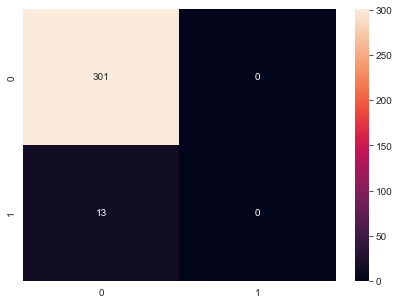

In [46]:
# Classification Accuracy
print('Accuracy on Training data:',model.score(X_train, y_train))
print('Accuracy on Test data:',model.score(X_test, y_test))

# Classification Report
print("Classification Report:\n",classification_report(y_test, model_pred))

# Confusion Matrix
print("Confusion Matrix Chart:")
cm = confusion_matrix(y_test, model_pred, labels=[0, 1])
df_cm = pd.DataFrame(cm, index = [i for i in ["0","1"]],
                  columns = [i for i in ["0","1"]])
plt.figure(figsize = (7,5))
sns.heatmap(df_cm, annot=True, fmt='g')
plt.show()

In [47]:
# Default Parameters used in the base model:
print(model)

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
              gamma=0, gpu_id=-1, importance_type=None,
              interaction_constraints='', learning_rate=0.300000012,
              max_delta_step=0, max_depth=6, min_child_weight=1, missing=nan,
              monotone_constraints='()', n_estimators=100, n_jobs=2,
              num_parallel_tree=1, predictor='auto', random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=0)


### 5B. Improve performance of the XGBoost as much as possible.

#### Case-1: Using oversampling over complete dataset

In [48]:
print('Before oversampling distribution of target vector:')
print(y.value_counts())

Before oversampling distribution of target vector:
0    1463
1     104
Name: Pass/Fail, dtype: int64


In [49]:
# Using SMOTE
# Create the oversampler. 
smt = SMOTE(random_state=0)
X1, y1 = smt.fit_sample(X, y)

In [50]:
# Target vector is balanced after oversampling
print('After oversampling distribution of target vector:')
print(y1.value_counts())

After oversampling distribution of target vector:
0    1463
1    1463
Name: Pass/Fail, dtype: int64


In [51]:
# Split X and y into training and test set in 80:20 ratio
X_train, X_test, y_train, y_test = train_test_split(X1, y1, test_size=0.20, random_state=0)

In [52]:
# Build the model
model = xgb.XGBClassifier(n_jobs=2, random_state=0, verbosity=0)

# Train the model
model.fit(X_train, y_train)
model_pred = model.predict(X_test)

Accuracy on Training data: 1.0
Accuracy on Test data: 0.9795221843003413
Classification Report:
               precision    recall  f1-score   support

           0       0.97      0.99      0.98       307
           1       0.99      0.97      0.98       279

    accuracy                           0.98       586
   macro avg       0.98      0.98      0.98       586
weighted avg       0.98      0.98      0.98       586

Confusion Matrix Chart:


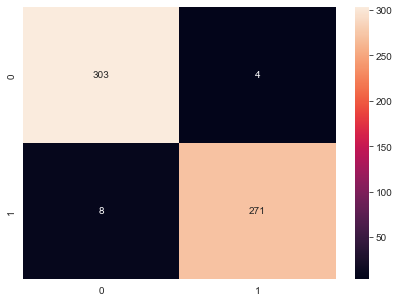

In [53]:
# Classification Accuracy
print('Accuracy on Training data:',model.score(X_train, y_train))
print('Accuracy on Test data:',model.score(X_test, y_test))

# Classification Report
print("Classification Report:\n",classification_report(y_test, model_pred))

# Confusion Matrix
print("Confusion Matrix Chart:")
cm = confusion_matrix(y_test, model_pred, labels=[0, 1])
df_cm = pd.DataFrame(cm, index = [i for i in ["0","1"]],
                  columns = [i for i in ["0","1"]])
plt.figure(figsize = (7,5))
sns.heatmap(df_cm, annot=True, fmt='g')
plt.show()

#### Case-2: Using oversampling over training dataset only

In [54]:
# Split X and y into training and test set in 80:20 ratio
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=0)

In [55]:
# Using SMOTE
# Create the oversampler.
smt = SMOTE(random_state=0)
X1, y1 = smt.fit_sample(X_train, y_train)

In [56]:
# Build the model
model = xgb.XGBClassifier(n_jobs=2, random_state=0, verbosity=0)

# Train the model
model.fit(X1, y1)
model_pred = model.predict(X_test)

Accuracy on Training data: 1.0
Accuracy on Test data: 0.9394904458598726
Classification Report:
               precision    recall  f1-score   support

           0       0.96      0.98      0.97       301
           1       0.00      0.00      0.00        13

    accuracy                           0.94       314
   macro avg       0.48      0.49      0.48       314
weighted avg       0.92      0.94      0.93       314

Confusion Matrix Chart:


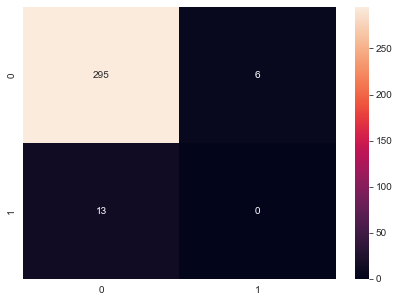

In [57]:
# Classification Accuracy
print('Accuracy on Training data:',model.score(X_train, y_train))
print('Accuracy on Test data:',model.score(X_test, y_test))

# Classification Report
print("Classification Report:\n",classification_report(y_test, model_pred))

# Confusion Matrix
print("Confusion Matrix Chart:")
cm = confusion_matrix(y_test, model_pred, labels=[0, 1])
df_cm = pd.DataFrame(cm, index = [i for i in ["0","1"]],
                  columns = [i for i in ["0","1"]])
plt.figure(figsize = (7,5))
sns.heatmap(df_cm, annot=True, fmt='g')
plt.show()

#### Case-3: Using hyperparameter tuning with Oversampling

In [58]:
# Build the model
model = xgb.XGBClassifier(n_jobs=2, random_state=0, verbosity=0)

params = {'max_depth': [3, 5, 6, 10, 15, 20],
          'learning_rate': [0.01, 0.1, 0.2, 0.3],
          'subsample': np.arange(0.5, 1.0, 0.1),
          'colsample_bytree': np.arange(0.4, 1.0, 0.1),
          'colsample_bylevel': np.arange(0.4, 1.0, 0.1),
          'n_estimators': [100, 500, 1000],
          'min_child_weight': [0.5, 1.0, 3.0, 5.0, 7.0, 10.0],
          'gamma':[i/10.0 for i in range(0,5)],
          'reg_alpha':[1e-5, 1e-2, 0.1, 1, 100],
          'reg_lambda': [0.1, 1.0, 5.0, 10.0, 50.0, 100.0]}

gs = RandomizedSearchCV(estimator=model, param_distributions=params, cv=5, verbose=10, n_jobs=2, random_state=0)
gs.fit(X1, y1)

Fitting 5 folds for each of 10 candidates, totalling 50 fits


RandomizedSearchCV(cv=5,
                   estimator=XGBClassifier(base_score=None, booster=None,
                                           colsample_bylevel=None,
                                           colsample_bynode=None,
                                           colsample_bytree=None,
                                           enable_categorical=False, gamma=None,
                                           gpu_id=None, importance_type=None,
                                           interaction_constraints=None,
                                           learning_rate=None,
                                           max_delta_step=None, max_depth=None,
                                           min_child_weight=None, missing=nan,
                                           monotone_constraints...
                                        'colsample_bytree': array([0.4, 0.5, 0.6, 0.7, 0.8, 0.9]),
                                        'gamma': [0.0, 0.1, 0.2, 0.3, 0.4],
      

In [59]:
pd.DataFrame({'param': gs.cv_results_["params"], 
              'score mean': gs.cv_results_["mean_test_score"], 
              'score s.d.': gs.cv_results_["std_test_score"],
              'rank': gs.cv_results_["rank_test_score"]})

,param,score mean,score s.d.,rank
0,"{'subsample': 0.8999999999999999, 'reg_lambda'...",0.962574,0.052297,5
1,"{'subsample': 0.5, 'reg_lambda': 1.0, 'reg_alp...",0.957836,0.039524,9
2,"{'subsample': 0.8999999999999999, 'reg_lambda'...",0.962573,0.037899,6
3,"{'subsample': 0.8999999999999999, 'reg_lambda'...",0.971608,0.038597,3
4,"{'subsample': 0.5, 'reg_lambda': 10.0, 'reg_al...",0.958268,0.033216,8
5,"{'subsample': 0.7999999999999999, 'reg_lambda'...",0.970744,0.030911,4
6,"{'subsample': 0.8999999999999999, 'reg_lambda'...",0.974616,0.035004,2
7,"{'subsample': 0.8999999999999999, 'reg_lambda'...",0.977632,0.036153,1
8,"{'subsample': 0.6, 'reg_lambda': 5.0, 'reg_alp...",0.961713,0.043358,7
9,"{'subsample': 0.7999999999999999, 'reg_lambda'...",0.886846,0.033522,10


In [60]:
print('Best Parameters:', gs.best_params_, 'mean score: ', gs.best_score_, sep='\n')

Best Parameters:
{'subsample': 0.8999999999999999, 'reg_lambda': 1.0, 'reg_alpha': 0.01, 'n_estimators': 100, 'min_child_weight': 0.5, 'max_depth': 20, 'learning_rate': 0.2, 'gamma': 0.3, 'colsample_bytree': 0.6, 'colsample_bylevel': 0.8999999999999999}
mean score: 
0.9776316277345198


In [61]:
# Build the model
model = xgb.XGBClassifier(n_jobs=2, random_state=0, subsample=0.899999999999999, reg_lambda=1.0, reg_alpha=0.01, n_estimators=100, 
                          min_child_weight=0.5, max_depth=20, learning_rate=0.2, gamma=0.3, 
                          colsample_bytree=0.6, colsample_bylevel=0.8999999999999999, verbosity=0)

# Train the model
model.fit(X1, y1)
model_pred = model.predict(X_test)

Accuracy on Training data: 1.0
Accuracy on Test data: 0.9522292993630573
Classification Report:
               precision    recall  f1-score   support

           0       0.96      0.99      0.98       301
           1       0.00      0.00      0.00        13

    accuracy                           0.95       314
   macro avg       0.48      0.50      0.49       314
weighted avg       0.92      0.95      0.94       314

Confusion Matrix Chart:


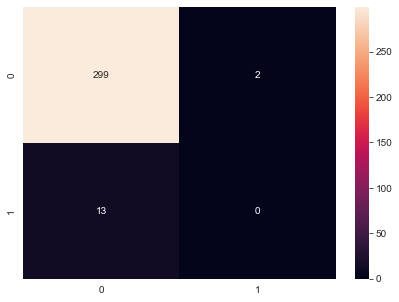

In [62]:
# Classification Accuracy
print('Accuracy on Training data:',model.score(X_train, y_train))
print('Accuracy on Test data:',model.score(X_test, y_test))

# Classification Report
print("Classification Report:\n",classification_report(y_test, model_pred))

# Confusion Matrix
print("Confusion Matrix Chart:")
cm = confusion_matrix(y_test, model_pred, labels=[0, 1])
df_cm = pd.DataFrame(cm, index = [i for i in ["0","1"]],
                  columns = [i for i in ["0","1"]])
plt.figure(figsize = (7,5))
sns.heatmap(df_cm, annot=True, fmt='g')
plt.show()

#### Case-4: Using hyperparameter tuning without oversampling

In [63]:
# Build the model
model = xgb.XGBClassifier(n_jobs=2, random_state=0, verbosity=0)

params = {'max_depth': [3, 5, 6, 10, 15, 20],
          'learning_rate': [0.01, 0.1, 0.2, 0.3],
          'subsample': np.arange(0.5, 1.0, 0.1),
          'colsample_bytree': np.arange(0.4, 1.0, 0.1),
          'colsample_bylevel': np.arange(0.4, 1.0, 0.1),
          'n_estimators': [100, 500, 1000],
          'min_child_weight': [0.5, 1.0, 3.0, 5.0, 7.0, 10.0],
          'gamma':[i/10.0 for i in range(0,5)],
          'reg_alpha':[1e-5, 1e-2, 0.1, 1, 100],
          'reg_lambda': [0.1, 1.0, 5.0, 10.0, 50.0, 100.0]}

gs = RandomizedSearchCV(estimator=model, param_distributions=params, cv=5, verbose=10, n_jobs=2, random_state=0)
gs.fit(X_train, y_train)

Fitting 5 folds for each of 10 candidates, totalling 50 fits


RandomizedSearchCV(cv=5,
                   estimator=XGBClassifier(base_score=None, booster=None,
                                           colsample_bylevel=None,
                                           colsample_bynode=None,
                                           colsample_bytree=None,
                                           enable_categorical=False, gamma=None,
                                           gpu_id=None, importance_type=None,
                                           interaction_constraints=None,
                                           learning_rate=None,
                                           max_delta_step=None, max_depth=None,
                                           min_child_weight=None, missing=nan,
                                           monotone_constraints...
                                        'colsample_bytree': array([0.4, 0.5, 0.6, 0.7, 0.8, 0.9]),
                                        'gamma': [0.0, 0.1, 0.2, 0.3, 0.4],
      

In [64]:
pd.DataFrame({'param': gs.cv_results_["params"], 
              'score mean': gs.cv_results_["mean_test_score"], 
              'score s.d.': gs.cv_results_["std_test_score"],
              'rank': gs.cv_results_["rank_test_score"]})

,param,score mean,score s.d.,rank
0,"{'subsample': 0.8999999999999999, 'reg_lambda'...",0.929766,0.002048,1
1,"{'subsample': 0.5, 'reg_lambda': 1.0, 'reg_alp...",0.902623,0.009742,10
2,"{'subsample': 0.8999999999999999, 'reg_lambda'...",0.927375,0.001542,4
3,"{'subsample': 0.8999999999999999, 'reg_lambda'...",0.928172,0.002524,2
4,"{'subsample': 0.5, 'reg_lambda': 10.0, 'reg_al...",0.927375,0.001542,4
5,"{'subsample': 0.7999999999999999, 'reg_lambda'...",0.925772,0.007020,8
6,"{'subsample': 0.8999999999999999, 'reg_lambda'...",0.926578,0.001861,7
7,"{'subsample': 0.8999999999999999, 'reg_lambda'...",0.928172,0.002524,2
8,"{'subsample': 0.6, 'reg_lambda': 5.0, 'reg_alp...",0.919385,0.007819,9
9,"{'subsample': 0.7999999999999999, 'reg_lambda'...",0.927375,0.001542,4


In [65]:
# Print the best parameters
print('Best Parameters:', gs.best_params_, 'mean score: ', gs.best_score_, sep='\n')

Best Parameters:
{'subsample': 0.8999999999999999, 'reg_lambda': 50.0, 'reg_alpha': 0.01, 'n_estimators': 1000, 'min_child_weight': 5.0, 'max_depth': 20, 'learning_rate': 0.1, 'gamma': 0.3, 'colsample_bytree': 0.5, 'colsample_bylevel': 0.7999999999999999}
mean score: 
0.9297657370517929


In [66]:
# Build the model
model = xgb.XGBClassifier(n_jobs=2, random_state=0, subsample=0.899999999999999, reg_lambda=50.0, reg_alpha=0.01, n_estimators=1000, 
                          min_child_weight=5.0, max_depth=20, learning_rate=0.1, gamma=0.3, 
                          colsample_bytree=0.5, colsample_bylevel=0.7999999999999999, verbosity=0)

# Train the model
model.fit(X_train, y_train)
model_pred = model.predict(X_test)

<Figure size 7200x6480 with 0 Axes>

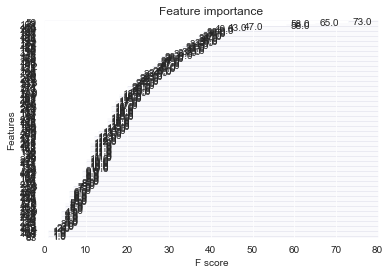

In [67]:
# Plot features importance chart
plt.figure(figsize=(100,90))
plot_importance(model)
plt.show()

Accuracy on Training data: 1.0
Accuracy on Test data: 0.9585987261146497
Classification Report:
               precision    recall  f1-score   support

           0       0.96      1.00      0.98       301
           1       0.00      0.00      0.00        13

    accuracy                           0.96       314
   macro avg       0.48      0.50      0.49       314
weighted avg       0.92      0.96      0.94       314

Confusion Matrix Chart:


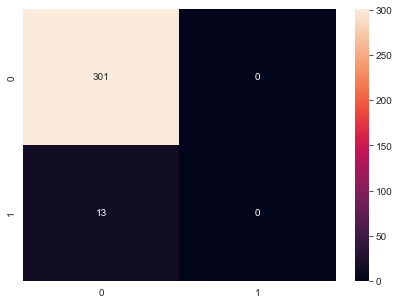

In [68]:
# Classification Accuracy
print('Accuracy on Training data:',model.score(X_train, y_train))
print('Accuracy on Test data:',model.score(X_test, y_test))

# Classification Report
print("Classification Report:\n",classification_report(y_test, model_pred))

# Confusion Matrix
print("Confusion Matrix Chart:")
cm = confusion_matrix(y_test, model_pred, labels=[0, 1])
df_cm = pd.DataFrame(cm, index = [i for i in ["0","1"]],
                  columns = [i for i in ["0","1"]])
plt.figure(figsize = (7,5))
sns.heatmap(df_cm, annot=True, fmt='g')
plt.show()

### 5C. Consider all the possible models

#### Select  the best performing model without PCA

In [69]:
# Use K-Fold Cross Validation for model selection
# Define various classification models
LR_model=LogisticRegression(n_jobs=2, random_state=0)
KNN_model=KNeighborsClassifier(n_jobs=2)
GNB_model=GaussianNB()
# SVM_model_linear=SVC(kernel='linear',random_state=0)
# SVM_model_rbf=SVC(kernel='rbf',random_state=0)
# SVM_model_poly=SVC(kernel='poly',random_state=0)
RandomForest=RandomForestClassifier(n_jobs=2, random_state=0)
BaggingClassifier=BaggingClassifier(n_jobs=2, random_state=0)
AdaBoostClassifier=AdaBoostClassifier(random_state=0)
GBClassifier=GradientBoostingClassifier(random_state=0)
XGBClassifier=xgb.XGBClassifier(n_jobs=2, random_state=0, verbosity = 0)
LGBMClassifier=LGBMClassifier(n_jobs=2, random_state=0)
# CatBoostClassifier=CatBoostClassifier(thread_count=2, random_seed=0)

Hybrid = []
Hybrid.append(['RidgeClassifier',RidgeClassifier(random_state=0)])
Hybrid.append(['LogisticRegression',LogisticRegression(n_jobs=2, random_state=0)])
Hybrid.append(['SVM',SVC(random_state=0)])
Hybrid.append(['KNeigbors',KNeighborsClassifier(n_jobs=2)])
Hybrid.append(['GaussianNB',GaussianNB()])
Hybrid.append(['BernoulliNB',BernoulliNB()])
Hybrid.append(['DecisionTree',DecisionTreeClassifier(random_state=0)])

Hybrid_Ensemble=VotingClassifier(Hybrid, n_jobs=2)

LR_Model: 0.926610 (0.015314)
KNN_Model: 0.921041 (0.021027)
GNB_Model: 0.859537 (0.034906)
RandomForest: 0.926610 (0.014890)
BaggingClassifier: 0.916235 (0.018137)
AdaBoostClassifier: 0.910654 (0.016039)
GBClassifier: 0.917822 (0.016267)
XGBClassifier: 0.925816 (0.014955)
LGBMClassifier: 0.926610 (0.014890)
Hybrid_Ensemble: 0.926610 (0.015314)


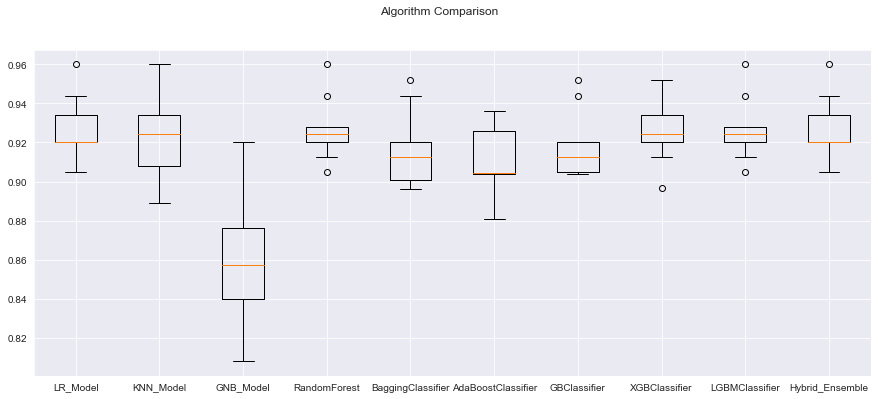

In [70]:
# K Fold Cross Validation Scores

seed = 0

# Create models
models = []

models.append(('LR_Model', LR_model))
models.append(('KNN_Model', KNN_model))
models.append(('GNB_Model', GNB_model))
# models.append(('SVM_Linear', SVM_model_linear))
# models.append(('SVM_Rbf', SVM_model_rbf))
# models.append(('SVM_Poly', SVM_model_poly))
models.append(('RandomForest', RandomForest))
models.append(('BaggingClassifier', BaggingClassifier))
models.append(('AdaBoostClassifier', AdaBoostClassifier))
models.append(('GBClassifier', GBClassifier))
models.append(('XGBClassifier', XGBClassifier))
models.append(('LGBMClassifier', LGBMClassifier))
# models.append(('CatBoostClassifier', CatBoostClassifier))
models.append(('Hybrid_Ensemble', Hybrid_Ensemble))

# Evaluate each model in turn
results = []
names = []

# Use different metrics based on context
scoring = 'accuracy'
# scoring = 'precision'
# scoring = 'recall'
# scoring = 'f1'
for name, model in models:
	kfold = model_selection.KFold(n_splits=10,random_state=seed,shuffle=True)
	cv_results = model_selection.cross_val_score(model, X_train, y_train, cv=kfold, scoring=scoring, n_jobs=2)
	results.append(cv_results)
	names.append(name)
	msg = "%s: %f (%f)" % (name, cv_results.mean(), cv_results.std())
	print(msg)
    
# Boxplot for algorithm comparison
fig = plt.figure(figsize=(15,6))
fig.suptitle('Algorithm Comparison')
ax = fig.add_subplot(111)
plt.boxplot(results)
ax.set_xticklabels(names)
plt.show()

In [71]:
# Use SMOTE to handle the imbalanced dataset
# Create the oversampler.
# smote=SMOTE(random_state=0)
# X1, y1=smote.fit_resample(X_train, y_train)
# sampling_strategy=0.5

# Using SMOTE
smt = SMOTE(random_state=0)
X1, y1 = smt.fit_sample(X_train, y_train)

# Using random under sampling
# under= RandomUnderSampler(random_state=0)
# X1, y1 = under.fit_sample(X_train, y_train)

# # Using random over sampling
# over= RandomOverSampler(random_state=0)
# X1, y1 = over.fit_sample(X_train, y_train)

# # Using ADASYN
# oversample = ADASYN(random_state=0)
# X1, y1 = oversample.fit_resample(X_train, y_train)

In [72]:
base_1 = []
for m in range(len(models)):
    base_2 = []
    model = models[m][1]
    model.fit(X1,y1)
    y_pred = model.predict(X_test)
    y1_pred = model.predict(X1)
    cm = confusion_matrix(y_test,y_pred)
    accuracies = cross_val_score(estimator= model, X = X1, y = y1, cv=10)

# k-fOLD Validation
    roc = roc_auc_score(y_test,y_pred)
    precision = precision_score(y_test,y_pred)
    recall = recall_score(y_test,y_pred)
    f1 = f1_score(y_test,y_pred)
    print(models[m][0],':')
    print(cm)
    print('Train Accuracy Score: ',accuracy_score(y1,y1_pred))
    print('Test Accuracy Score: ',accuracy_score(y_test,y_pred))
    print('K-Fold Validation Mean Accuracy: {:.2f} %;'.format(accuracies.mean()*100), 
          'Standard Deviation: {:.2f} %'.format(accuracies.std()*100))
    print('ROC AUC Score: {:.2f} %'.format(roc))
    print('Precision: {:.2f} %'.format(precision))
    print('Recall: {:.2f} %'.format(recall))
    print('F1 Score: {:.2f} %'.format(f1))
    print('Classification Report:')
    print(classification_report(y_test, y_pred)) 
    print('-'*60)
    base_2.append(models[m][0])
    base_2.append(accuracy_score(y1,y1_pred)*100)
    base_2.append(accuracy_score(y_test,y_pred)*100)
    base_2.append(accuracies.mean()*100)
    base_2.append(accuracies.std()*100)
    base_2.append(roc)
    base_2.append(precision)
    base_2.append(recall)
    base_2.append(f1)
    base_1.append(base_2)

LR_Model :
[[189 112]
 [  8   5]]
Train Accuracy Score:  0.7018072289156626
Test Accuracy Score:  0.6178343949044586
K-Fold Validation Mean Accuracy: 68.94 %; Standard Deviation: 2.94 %
ROC AUC Score: 0.51 %
Precision: 0.04 %
Recall: 0.38 %
F1 Score: 0.08 %
Classification Report:
              precision    recall  f1-score   support

           0       0.96      0.63      0.76       301
           1       0.04      0.38      0.08        13

    accuracy                           0.62       314
   macro avg       0.50      0.51      0.42       314
weighted avg       0.92      0.62      0.73       314

------------------------------------------------------------
KNN_Model :
[[186 115]
 [  7   6]]
Train Accuracy Score:  0.8347676419965576
Test Accuracy Score:  0.6114649681528662
K-Fold Validation Mean Accuracy: 78.14 %; Standard Deviation: 1.72 %
ROC AUC Score: 0.54 %
Precision: 0.05 %
Recall: 0.46 %
F1 Score: 0.09 %
Classification Report:
              precision    recall  f1-score   sup

In [73]:
model_comparison = pd.DataFrame(base_1,columns=['Model','Train_Accuracy','Test_Accuracy','K-Fold Mean Accuracy',
                                                'Std.Deviation','ROC_AUC','Precision','Recall','F1 Score'])

model_comparison.sort_values(by=['Recall','F1 Score'],inplace=True,ascending=False)
model_comparison

,Model,Train_Accuracy,Test_Accuracy,K-Fold Mean Accuracy,Std.Deviation,ROC_AUC,Precision,Recall,F1 Score
2,GNB_Model,84.509466,79.617834,83.652694,4.631645,0.746486,0.130435,0.692308,0.219512
1,KNN_Model,83.476764,61.146497,78.141187,1.720249,0.539739,0.049587,0.461538,0.089552
9,Hybrid_Ensemble,91.996558,81.847134,89.545101,2.433906,0.610912,0.092593,0.384615,0.149254
0,LR_Model,70.180723,61.783439,68.936288,2.937424,0.506261,0.042735,0.384615,0.076923
5,AdaBoostClassifier,96.729776,89.171975,92.088020,6.182703,0.538717,0.080000,0.153846,0.105263
6,GBClassifier,99.956971,92.675159,96.347122,6.171922,0.520189,0.083333,0.076923,0.080000
3,RandomForest,100.000000,95.222930,99.140706,1.448820,0.496678,0.000000,0.000000,0.000000
4,BaggingClassifier,99.913941,93.630573,95.655801,3.571499,0.488372,0.000000,0.000000,0.000000
7,XGBClassifier,100.000000,93.949045,97.766020,4.281756,0.490033,0.000000,0.000000,0.000000
8,LGBMClassifier,100.000000,94.904459,97.809309,4.761479,0.495017,0.000000,0.000000,0.000000


**Best Model: Gaussian Naive Bayes based on ROC_AUC, Precision, Recall and F1 Score**

1. Prediction of class Recall is the most important parameter to decide the best model for this problem. Gaussian NB has the highest Recall value here.
2. Both KNN and Hybrid_ensemble are next to the Gaussian NB in performance.
3. A lot of over-fitting is visible in a number of models like Random Forest, BaggingClassifier, XGB and LGBM.
4. A balanced dataset would further improve the performance.
5. Hyper-parameter tuning of the base model may improve the performance. This is continued below...

#### Using hyperparameter tuning without oversampling

In [74]:
# Build the model
model = GaussianNB()

params = {'var_smoothing': np.logspace(0,-9, num=100)
          }

gs = RandomizedSearchCV(estimator=model, param_distributions=params, cv=5, verbose=10, n_jobs=2, random_state=0)
gs.fit(X_train, y_train)

Fitting 5 folds for each of 10 candidates, totalling 50 fits


RandomizedSearchCV(cv=5, estimator=GaussianNB(), n_jobs=2,
                   param_distributions={'var_smoothing': array([1.00000000e+00, 8.11130831e-01, 6.57933225e-01, 5.33669923e-01,
       4.32876128e-01, 3.51119173e-01, 2.84803587e-01, 2.31012970e-01,
       1.87381742e-01, 1.51991108e-01, 1.23284674e-01, 1.00000000e-01,
       8.11130831e-02, 6.57933225e-02, 5.33669923e-02, 4.32876128e-02,
       3.51119173...
       1.23284674e-07, 1.00000000e-07, 8.11130831e-08, 6.57933225e-08,
       5.33669923e-08, 4.32876128e-08, 3.51119173e-08, 2.84803587e-08,
       2.31012970e-08, 1.87381742e-08, 1.51991108e-08, 1.23284674e-08,
       1.00000000e-08, 8.11130831e-09, 6.57933225e-09, 5.33669923e-09,
       4.32876128e-09, 3.51119173e-09, 2.84803587e-09, 2.31012970e-09,
       1.87381742e-09, 1.51991108e-09, 1.23284674e-09, 1.00000000e-09])},
                   random_state=0, verbose=10)

In [75]:
pd.DataFrame({'param': gs.cv_results_["params"], 
              'score mean': gs.cv_results_["mean_test_score"], 
              'score s.d.': gs.cv_results_["std_test_score"],
              'rank': gs.cv_results_["rank_test_score"]})

,param,score mean,score s.d.,rank
0,{'var_smoothing': 0.004328761281083057},0.927375,0.001542,1
1,{'var_smoothing': 1.519911082952933e-08},0.869116,0.018576,8
2,{'var_smoothing': 0.657933224657568},0.927375,0.001542,1
3,{'var_smoothing': 1e-05},0.913004,0.006923,4
4,{'var_smoothing': 1.519911082952933e-07},0.888271,0.012573,7
5,{'var_smoothing': 3.5111917342151273e-09},0.861925,0.022673,10
6,{'var_smoothing': 0.03511191734215131},0.927375,0.001542,1
7,{'var_smoothing': 2.310129700083158e-07},0.889068,0.011641,6
8,{'var_smoothing': 1.2328467394420658e-05},0.913001,0.006490,5
9,{'var_smoothing': 2.310129700083158e-09},0.862716,0.024336,9


In [76]:
# Print the best parameters
print('Best Parameters:', gs.best_params_, 'mean score: ', gs.best_score_, sep='\n')

Best Parameters:
{'var_smoothing': 0.004328761281083057}
mean score: 
0.9273752988047809


In [77]:
# Build the model
model = GaussianNB(var_smoothing=0.004328761281083057)

# Train the model
model.fit(X_train, y_train)
model_pred = model.predict(X_test)

Accuracy on Training data: 0.9273743016759777
Accuracy on Test data: 0.9585987261146497
Classification Report:
               precision    recall  f1-score   support

           0       0.96      1.00      0.98       301
           1       0.00      0.00      0.00        13

    accuracy                           0.96       314
   macro avg       0.48      0.50      0.49       314
weighted avg       0.92      0.96      0.94       314

Confusion Matrix Chart:


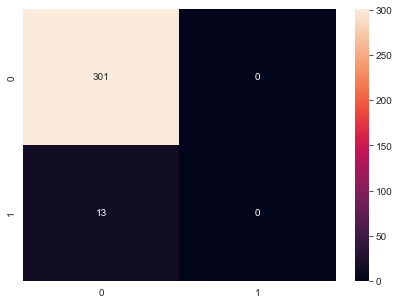

In [78]:
# Classification Accuracy
print('Accuracy on Training data:',model.score(X_train, y_train))
print('Accuracy on Test data:',model.score(X_test, y_test))

# Classification Report
print("Classification Report:\n",classification_report(y_test, model_pred))

# Confusion Matrix
print("Confusion Matrix Chart:")
cm = confusion_matrix(y_test, model_pred, labels=[0, 1])
df_cm = pd.DataFrame(cm, index = [i for i in ["0","1"]],
                  columns = [i for i in ["0","1"]])
plt.figure(figsize = (7,5))
sns.heatmap(df_cm, annot=True, fmt='g')
plt.show()

**We do not see much improvement in the model here.**

#### Using hyperparameter tuning with Oversampling

In [79]:
# Build the model
model = GaussianNB()

params = {'var_smoothing': np.logspace(0,-9, num=100)
          }

gs = RandomizedSearchCV(estimator=model, param_distributions=params, cv=5, verbose=10, n_jobs=2, random_state=0)
gs.fit(X1, y1)

Fitting 5 folds for each of 10 candidates, totalling 50 fits


RandomizedSearchCV(cv=5, estimator=GaussianNB(), n_jobs=2,
                   param_distributions={'var_smoothing': array([1.00000000e+00, 8.11130831e-01, 6.57933225e-01, 5.33669923e-01,
       4.32876128e-01, 3.51119173e-01, 2.84803587e-01, 2.31012970e-01,
       1.87381742e-01, 1.51991108e-01, 1.23284674e-01, 1.00000000e-01,
       8.11130831e-02, 6.57933225e-02, 5.33669923e-02, 4.32876128e-02,
       3.51119173...
       1.23284674e-07, 1.00000000e-07, 8.11130831e-08, 6.57933225e-08,
       5.33669923e-08, 4.32876128e-08, 3.51119173e-08, 2.84803587e-08,
       2.31012970e-08, 1.87381742e-08, 1.51991108e-08, 1.23284674e-08,
       1.00000000e-08, 8.11130831e-09, 6.57933225e-09, 5.33669923e-09,
       4.32876128e-09, 3.51119173e-09, 2.84803587e-09, 2.31012970e-09,
       1.87381742e-09, 1.51991108e-09, 1.23284674e-09, 1.00000000e-09])},
                   random_state=0, verbose=10)

In [80]:
pd.DataFrame({'param': gs.cv_results_["params"], 
              'score mean': gs.cv_results_["mean_test_score"], 
              'score s.d.': gs.cv_results_["std_test_score"],
              'rank': gs.cv_results_["rank_test_score"]})

,param,score mean,score s.d.,rank
0,{'var_smoothing': 0.004328761281083057},0.617476,0.018696,8
1,{'var_smoothing': 1.519911082952933e-08},0.835206,0.023295,3
2,{'var_smoothing': 0.657933224657568},0.519792,0.005067,10
3,{'var_smoothing': 1e-05},0.800348,0.019695,6
4,{'var_smoothing': 1.519911082952933e-07},0.835639,0.027101,1
5,{'var_smoothing': 3.5111917342151273e-09},0.835635,0.020425,2
6,{'var_smoothing': 0.03511191734215131},0.545182,0.012320,9
7,{'var_smoothing': 2.310129700083158e-07},0.831765,0.024175,5
8,{'var_smoothing': 1.2328467394420658e-05},0.793891,0.019429,7
9,{'var_smoothing': 2.310129700083158e-09},0.833053,0.021266,4


In [81]:
print('Best Parameters:', gs.best_params_, 'mean score: ', gs.best_score_, sep='\n')

Best Parameters:
{'var_smoothing': 1.519911082952933e-07}
mean score: 
0.8356386725991843


In [82]:
# Build the model
model = GaussianNB(var_smoothing=1.519911082952933e-07)

# Train the model
model.fit(X1, y1)
model_pred = model.predict(X_test)

Accuracy on Training data: 0.8036711891460495
Accuracy on Test data: 0.7802547770700637
Classification Report:
               precision    recall  f1-score   support

           0       0.96      0.80      0.87       301
           1       0.06      0.31      0.10        13

    accuracy                           0.78       314
   macro avg       0.51      0.55      0.49       314
weighted avg       0.93      0.78      0.84       314

Confusion Matrix Chart:


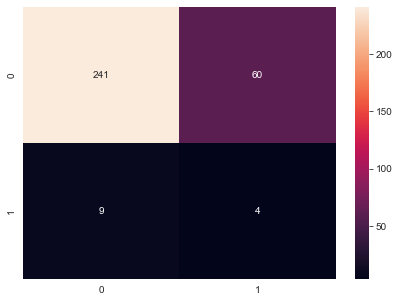

In [83]:
# Classification Accuracy
print('Accuracy on Training data:',model.score(X_train, y_train))
print('Accuracy on Test data:',model.score(X_test, y_test))

# Classification Report
print("Classification Report:\n",classification_report(y_test, model_pred))

# Confusion Matrix
print("Confusion Matrix Chart:")
cm = confusion_matrix(y_test, model_pred, labels=[0, 1])
df_cm = pd.DataFrame(cm, index = [i for i in ["0","1"]],
                  columns = [i for i in ["0","1"]])
plt.figure(figsize = (7,5))
sns.heatmap(df_cm, annot=True, fmt='g')
plt.show()

**Evaluation metrics allow us to estimate errors to determine how well our models
are performing:**

> Accuracy: ratio of correct predictions over total predictions.

> Precision: how often the classifier is correct when it predicts positive.

> Recall: how often the classifier is correct for all positive instances.

> F-Score: single measurement to combine precision and recall.

**We do not see much improvement in the model here either. Base model for Gaussian NB is still the best performing model.**

### 5D. Use PCA for various algorithms

In [84]:
# Load the data and pre-process for pca
dfb=pd.read_csv('signal-data.csv')
dfb=dfb.drop(['Time'],axis=1)

# Drop the columns that have constant signal
cols = dfb.select_dtypes([np.number]).columns
std = dfb[cols].std()
cols_to_drop = std[std==0].index
dfb.drop(cols_to_drop, axis=1,inplace=True)

# label encode the target class
dfb['Pass/Fail']=dfb['Pass/Fail'].replace([-1,1],[0,1])

# Replace the NaN/NA with zero and consider it as no signal
dfb.fillna(0,inplace=True)
row,column=dfb.shape
print('The dataset contains:', row, 'rows and', column, 'columns')

The dataset contains: 1567 rows and 475 columns


In [85]:
# Create the features matrix and target vector
X=dfb.drop(['Pass/Fail'], axis=1)
y=dfb['Pass/Fail']

#### Apply PCA on the data with all the components.

In [86]:
# Scaling the complete feature matrix
scaler = StandardScaler()
X = scaler.fit_transform(X)

In [87]:
# Calculating the covariance between attributes after scaling
# Covariance indicates the level to which two variables vary together.
cov_matrix = np.cov(X,rowvar=False)
print('Covariance Matrix:')
print(cov_matrix)

Covariance Matrix:
[[ 1.00063857 -0.04781282  0.00759455 ...  0.00523674  0.00392062
   0.02150242]
 [-0.04781282  1.00063857 -0.03046719 ...  0.03950455  0.04052574
   0.04449214]
 [ 0.00759455 -0.03046719  1.00063857 ... -0.00709495 -0.00912767
  -0.03045388]
 ...
 [ 0.00523674  0.03950455 -0.00709495 ...  1.00063857  0.97495406
   0.39175294]
 [ 0.00392062  0.04052574 -0.00912767 ...  0.97495406  1.00063857
   0.39014658]
 [ 0.02150242  0.04449214 -0.03045388 ...  0.39175294  0.39014658
   1.00063857]]


In [88]:
# Use PCA on all components
pca474 = PCA(n_components=474, random_state=0)
pca474.fit(X)

PCA(n_components=474, random_state=0)

In [89]:
# The eigen Values
print(pca474.explained_variance_)

[2.59359399e+01 1.85928732e+01 1.43217901e+01 1.22359151e+01
 1.06319413e+01 9.90123235e+00 9.32775892e+00 8.58057519e+00
 8.17436353e+00 8.08246094e+00 7.12278823e+00 6.87719205e+00
 6.59716313e+00 6.39757670e+00 6.22173838e+00 6.12527462e+00
 5.99244845e+00 5.64088928e+00 5.54809321e+00 5.32487951e+00
 5.23974818e+00 5.12453061e+00 4.92349097e+00 4.89172322e+00
 4.78569072e+00 4.57489247e+00 4.53074348e+00 4.51317740e+00
 4.41272848e+00 4.34260772e+00 4.24914012e+00 4.12486409e+00
 4.03525580e+00 3.84114743e+00 3.78399455e+00 3.68287986e+00
 3.63419647e+00 3.57053010e+00 3.50299795e+00 3.46936862e+00
 3.39397366e+00 3.33625841e+00 3.31433983e+00 3.18311325e+00
 3.14195881e+00 3.10974734e+00 3.09094993e+00 2.99053519e+00
 2.97587144e+00 2.96435817e+00 2.92097563e+00 2.83044267e+00
 2.78447553e+00 2.70204847e+00 2.69648951e+00 2.65684455e+00
 2.61689317e+00 2.57133341e+00 2.53004392e+00 2.44121205e+00
 2.42570520e+00 2.39284654e+00 2.35381752e+00 2.32996725e+00
 2.28625258e+00 2.223315

In [90]:
# The eigen Vectors
print(pca474.components_)

[[-8.58673171e-04 -1.77756063e-04  4.37982106e-04 ... -5.84918709e-04
  -1.16301761e-04  1.45867037e-02]
 [-1.31295956e-02  4.11469388e-03  2.26669101e-02 ...  1.72433440e-02
   1.38617814e-02  1.26662867e-02]
 [-4.57189887e-03 -9.90769876e-03 -5.82369234e-04 ... -1.48592032e-02
  -1.31641606e-02 -1.48902778e-02]
 ...
 [-0.00000000e+00 -1.80490125e-17  1.32412348e-16 ... -8.68771155e-18
   5.34612532e-17  2.48345530e-17]
 [-0.00000000e+00  1.50012883e-17 -1.20023943e-16 ...  3.47238824e-17
  -4.31432932e-17 -1.12905522e-16]
 [-0.00000000e+00  2.37937424e-18  1.32058987e-16 ...  6.30825227e-18
  -2.22712070e-18 -4.30513823e-18]]


In [91]:
# And the percentage of variation explained by each eigen Vector
print(pca474.explained_variance_ratio_)

[5.46822544e-02 3.92004387e-02 3.01954651e-02 2.57976933e-02
 2.24159418e-02 2.08753455e-02 1.96662580e-02 1.80909270e-02
 1.72344873e-02 1.70407237e-02 1.50173897e-02 1.44995850e-02
 1.39091837e-02 1.34883840e-02 1.31176538e-02 1.29142736e-02
 1.26342285e-02 1.18930158e-02 1.16973684e-02 1.12267539e-02
 1.10472666e-02 1.08043467e-02 1.03804831e-02 1.03135053e-02
 1.00899508e-02 9.64551255e-03 9.55243065e-03 9.51539507e-03
 9.30361275e-03 9.15577306e-03 8.95870987e-03 8.69669148e-03
 8.50776509e-03 8.09851509e-03 7.97801634e-03 7.76483036e-03
 7.66218833e-03 7.52795680e-03 7.38557483e-03 7.31467214e-03
 7.15571257e-03 7.03402814e-03 6.98781591e-03 6.71114326e-03
 6.62437496e-03 6.55646163e-03 6.51682997e-03 6.30511971e-03
 6.27420327e-03 6.24992917e-03 6.15846323e-03 5.96758731e-03
 5.87067212e-03 5.69688634e-03 5.68516606e-03 5.60158027e-03
 5.51734845e-03 5.42129215e-03 5.33423912e-03 5.14694972e-03
 5.11425572e-03 5.04497788e-03 4.96269073e-03 4.91240581e-03
 4.82023962e-03 4.687545

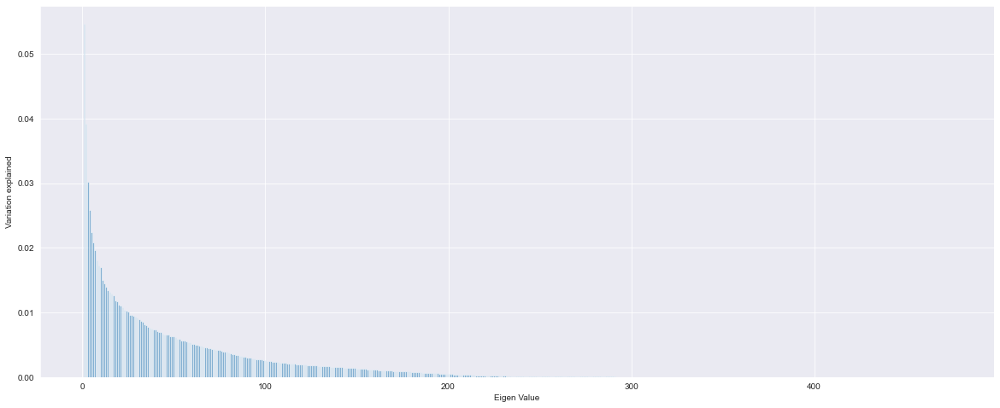

In [92]:
# Variation explained by each component
plt.figure(figsize=(20,8))
plt.bar(list(range(1,475)),pca474.explained_variance_ratio_,alpha=0.5, align='center')
plt.ylabel('Variation explained')
plt.xlabel('Eigen Value')
plt.show()

#### Visualize Cumulative Variance Explained with Number of Components.

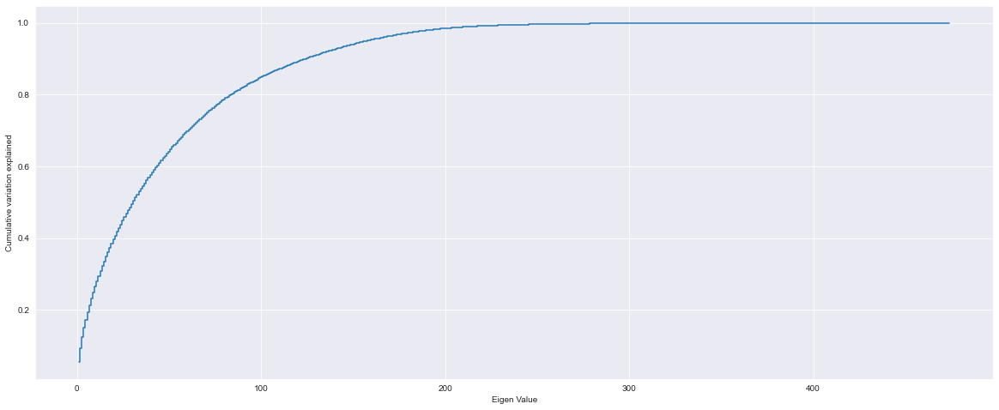

In [93]:
# Cumulative Variation explained by each component
plt.figure(figsize=(20,8))
plt.step(list(range(1,475)),np.cumsum(pca474.explained_variance_ratio_), where='mid')
plt.ylabel('Cumulative variation explained')
plt.xlabel('Eigen Value')
plt.show()

#### Draw a horizontal line on the above plot to highlight the threshold of 90%.

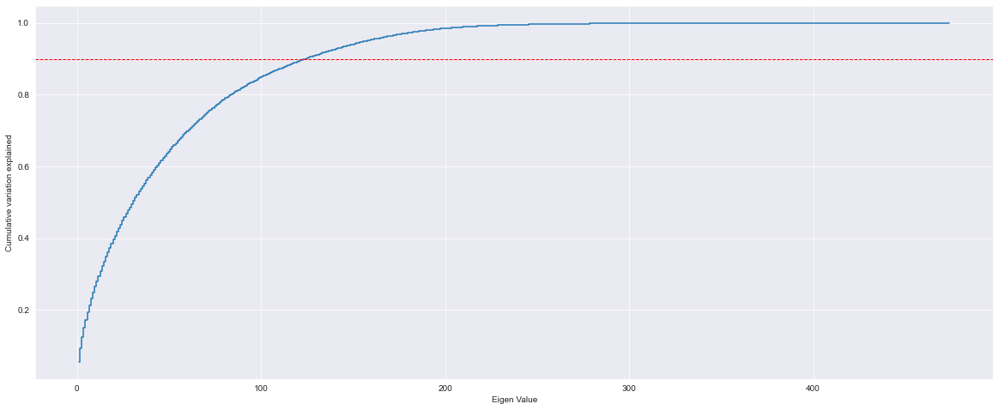

In [94]:
# Cumulative Variation explained by each component
# Red dashed line at 90% cumulative variation is explained by 120 principal components
plt.figure(figsize=(20,8))
plt.step(list(range(1,475)),np.cumsum(pca474.explained_variance_ratio_), where='mid')
plt.axhline(y=0.9, color='r', linestyle='--', lw=1)
plt.ylabel('Cumulative variation explained')
plt.xlabel('Eigen Value')
plt.show()

# Now 5 dimensions seems very reasonable. With 5 variables we can explain over 90% of the 
# variation in the original data!

#### Apply PCA on the data. This time Select Minimum Components with 90% or above variance explained.

In [95]:
# 120 principal components are able to explain more than 90% of variance in the data
pca120 = PCA(n_components=120)
pca120.fit(X)
print(pca120.components_)
print(pca120.explained_variance_ratio_)
Xpca120 = pca120.transform(X)

[[-8.58669179e-04 -1.77754778e-04  4.37981174e-04 ... -5.84919188e-04
  -1.16302151e-04  1.45867039e-02]
 [-1.31296076e-02  4.11468333e-03  2.26669067e-02 ...  1.72433393e-02
   1.38617785e-02  1.26662849e-02]
 [-4.57186813e-03 -9.90769788e-03 -5.82379970e-04 ... -1.48591821e-02
  -1.31641407e-02 -1.48902688e-02]
 ...
 [ 1.90466812e-01  8.98949775e-02  6.87171621e-03 ... -4.01081436e-02
  -3.79183572e-02  4.78868389e-02]
 [-3.45269925e-02  2.21255783e-02  4.49240221e-04 ...  3.27731267e-02
   3.86412000e-02 -2.72702323e-02]
 [-9.48055872e-02 -8.90297624e-04  5.86547197e-03 ...  1.96836874e-02
   1.84259622e-02  3.00929654e-02]]
[0.05468225 0.03920044 0.03019547 0.02579769 0.02241594 0.02087535
 0.01966626 0.01809093 0.01723449 0.01704072 0.01501739 0.01449958
 0.01390918 0.01348838 0.01311765 0.01291427 0.01263423 0.01189302
 0.01169737 0.01122675 0.01104727 0.01080435 0.01038048 0.0103135
 0.01008995 0.00964551 0.00955243 0.00951539 0.00930361 0.00915577
 0.00895871 0.00869669 0.00850

In [96]:
# Print the original features and the reduced features
print('Original number of features:', X.shape[1])
print('Reduced number of features:', Xpca120.shape[1])

Original number of features: 474
Reduced number of features: 120


In [97]:
# View the first 5 observations of the pca components
Xpca120_df = pd.DataFrame(data = Xpca120)
Xpca120_df.head()

,0,1,2,3,4,5,6,7,8,9,...,110,111,112,113,114,115,116,117,118,119
0,-1.384070,4.731427,3.939258,-0.238621,0.898079,-1.728461,0.528821,1.002061,2.006012,-0.619444,...,-0.455705,1.528334,0.486490,-1.461060,1.164346,-0.163955,-0.328833,1.743622,-0.486143,-0.239100
1,-1.941520,2.870300,3.319250,-0.522417,1.732292,-2.609242,-0.588128,-0.161185,2.668705,-2.283065,...,-1.774469,0.649335,-2.074290,-0.359878,1.673924,0.335374,1.077561,0.636174,-2.203748,-1.904500
2,0.283084,1.826429,0.154270,-0.215399,0.044945,-0.019925,-1.066383,-1.864146,2.578561,-1.305696,...,2.107172,0.237050,0.294126,-2.371228,3.600155,-0.353721,0.277751,-1.854836,-0.592071,0.669809
3,0.452161,1.960592,-2.782760,3.562078,-0.899073,-0.967236,-11.217079,-6.089510,28.759678,9.776305,...,-1.064902,-1.967494,0.440279,-0.494473,-3.324182,-0.070685,-0.565206,0.509972,-1.389437,-1.382477
4,0.386382,4.287058,2.361416,0.857856,0.106101,0.255076,-0.078898,-0.848727,3.225141,4.719088,...,0.014141,0.327414,2.047706,0.131210,0.784420,1.891169,2.154361,-1.035752,0.027967,0.167962


#### Create train and test datasets

In [98]:
X_train_row, X_train_col = X_train.shape
print('The X_train comprises of', X_train_row, 'rows and', X_train_col, 'columns.')

The X_train comprises of 1253 rows and 184 columns.


In [99]:
X_test_row, X_test_col = X_test.shape
print('The X_test comprises of', X_test_row, 'rows and', X_test_col, 'columns.')

The X_test comprises of 314 rows and 184 columns.


In [100]:
# Split the pca data into train and test ratio of 80:20
Xpca120_train, Xpca120_test, y_train, y_test = train_test_split(Xpca120, y, test_size=0.20, random_state=0)

In [101]:
Xpca120_train_row, Xpca120_train_col = Xpca120_train.shape
print('The Xpca120_train comprises of', Xpca120_train_row, 'rows and', Xpca120_train_col, 'columns.')

The Xpca120_train comprises of 1253 rows and 120 columns.


In [102]:
Xpca120_test_row,  Xpca120_test_col =  Xpca120_test.shape
print('The  Xpca120_test comprises of',  Xpca120_test_row, 'rows and',  Xpca120_test_col, 'columns.')

The  Xpca120_test comprises of 314 rows and 120 columns.


In [103]:
X_train=Xpca120_train
X_test=Xpca120_test

#### Select  the best performing model with PCA

LR_Model: 0.897873 (0.021837)
KNN_Model: 0.922629 (0.019722)
GNB_Model: 0.811581 (0.065071)
RandomForest: 0.924222 (0.017741)
BaggingClassifier: 0.913035 (0.021167)
AdaBoostClassifier: 0.906654 (0.017358)
GBClassifier: 0.912254 (0.022396)
XGBClassifier: 0.925803 (0.015041)
LGBMClassifier: 0.926610 (0.014890)
Hybrid_Ensemble: 0.924210 (0.015921)


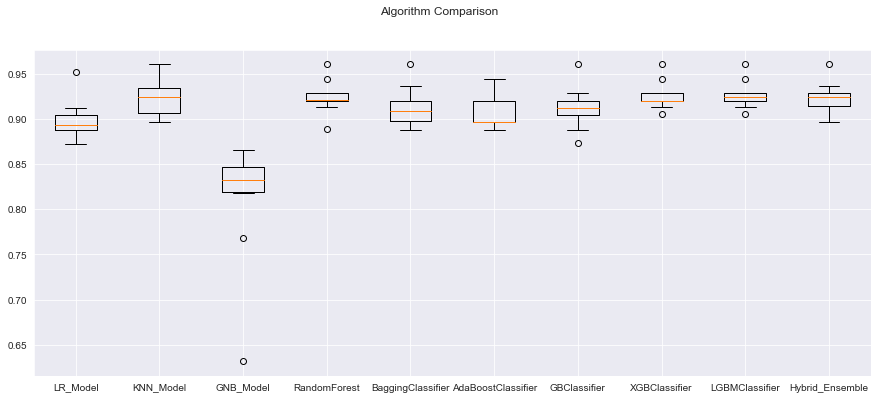

In [104]:
# K Fold Cross Validation Scores

seed = 0

# Create models
models = []

models.append(('LR_Model', LR_model))
models.append(('KNN_Model', KNN_model))
models.append(('GNB_Model', GNB_model))
# models.append(('SVM_Linear', SVM_model_linear))
# models.append(('SVM_Rbf', SVM_model_rbf))
# models.append(('SVM_Poly', SVM_model_poly))
models.append(('RandomForest', RandomForest))
models.append(('BaggingClassifier', BaggingClassifier))
models.append(('AdaBoostClassifier', AdaBoostClassifier))
models.append(('GBClassifier', GBClassifier))
models.append(('XGBClassifier', XGBClassifier))
models.append(('LGBMClassifier', LGBMClassifier))
# models.append(('CatBoostClassifier', CatBoostClassifier))
models.append(('Hybrid_Ensemble', Hybrid_Ensemble))

# Evaluate each model in turn
results = []
names = []

# Use different metrics based on context
scoring = 'accuracy'
# scoring = 'precision'
# scoring = 'recall'
# scoring = 'f1'
for name, model in models:
	kfold = model_selection.KFold(n_splits=10,random_state=seed,shuffle=True)
	cv_results = model_selection.cross_val_score(model, X_train, y_train, cv=kfold, scoring=scoring, n_jobs=2)
	results.append(cv_results)
	names.append(name)
	msg = "%s: %f (%f)" % (name, cv_results.mean(), cv_results.std())
	print(msg)
    
# Boxplot for algorithm comparison
fig = plt.figure(figsize=(15,6))
fig.suptitle('Algorithm Comparison')
ax = fig.add_subplot(111)
plt.boxplot(results)
ax.set_xticklabels(names)
plt.show()

In [105]:
# Use SMOTE to handle the imbalanced dataset
# Create the oversampler.
# smote=SMOTE(random_state=0)
# X1, y1=smote.fit_resample(X_train, y_train)
# sampling_strategy=0.5

# Using SMOTE
smt = SMOTE(random_state=0)
X1, y1 = smt.fit_sample(X_train, y_train)

# Using random under sampling
# under= RandomUnderSampler(random_state=0)
# X1, y1 = under.fit_sample(X_train, y_train)

# # Using random over sampling
# over= RandomOverSampler(random_state=0)
# X1, y1 = over.fit_sample(X_train, y_train)

# # Using ADASYN
# oversample = ADASYN(random_state=0)
# X1, y1 = oversample.fit_resample(X_train, y_train)


In [106]:
base_1 = []
for m in range(len(models)):
    base_2 = []
    model = models[m][1]
    model.fit(X1,y1)
    y_pred = model.predict(X_test)
    y1_pred = model.predict(X1)
    cm = confusion_matrix(y_test,y_pred)
    accuracies = cross_val_score(estimator= model, X = X1, y = y1, cv=10)

# k-fOLD Validation
    roc = roc_auc_score(y_test,y_pred)
    precision = precision_score(y_test,y_pred)
    recall = recall_score(y_test,y_pred)
    f1 = f1_score(y_test,y_pred)
    print(models[m][0],':')
    print(cm)
    print('Train Accuracy Score: ',accuracy_score(y1,y1_pred))
    print('Test Accuracy Score: ',accuracy_score(y_test,y_pred))
    print('K-Fold Validation Mean Accuracy: {:.2f} %;'.format(accuracies.mean()*100), 
          'Standard Deviation: {:.2f} %'.format(accuracies.std()*100))
    print('ROC AUC Score: {:.2f} %'.format(roc))
    print('Precision: {:.2f} %'.format(precision))
    print('Recall: {:.2f} %'.format(recall))
    print('F1 Score: {:.2f} %'.format(f1))
    print('Classification Report:')
    print(classification_report(y_test, y_pred)) 
    print('-'*60)
    base_2.append(models[m][0])
    base_2.append(accuracy_score(y1,y1_pred)*100)
    base_2.append(accuracy_score(y_test,y_pred)*100)
    base_2.append(accuracies.mean()*100)
    base_2.append(accuracies.std()*100)
    base_2.append(roc)
    base_2.append(precision)
    base_2.append(recall)
    base_2.append(f1)
    base_1.append(base_2)

LR_Model :
[[226  75]
 [  9   4]]
Train Accuracy Score:  0.8717728055077453
Test Accuracy Score:  0.732484076433121
K-Fold Validation Mean Accuracy: 84.43 %; Standard Deviation: 2.40 %
ROC AUC Score: 0.53 %
Precision: 0.05 %
Recall: 0.31 %
F1 Score: 0.09 %
Classification Report:
              precision    recall  f1-score   support

           0       0.96      0.75      0.84       301
           1       0.05      0.31      0.09        13

    accuracy                           0.73       314
   macro avg       0.51      0.53      0.47       314
weighted avg       0.92      0.73      0.81       314

------------------------------------------------------------
KNN_Model :
[[133 168]
 [  4   9]]
Train Accuracy Score:  0.7771084337349398
Test Accuracy Score:  0.45222929936305734
K-Fold Validation Mean Accuracy: 70.57 %; Standard Deviation: 1.84 %
ROC AUC Score: 0.57 %
Precision: 0.05 %
Recall: 0.69 %
F1 Score: 0.09 %
Classification Report:
              precision    recall  f1-score   sup

In [107]:
model_comparison = pd.DataFrame(base_1,columns=['Model','Train_Accuracy','Test_Accuracy','K-Fold Mean Accuracy',
                                                'Std.Deviation','ROC_AUC','Precision','Recall','F1 Score'])

model_comparison.sort_values(by=['Recall','F1 Score'],inplace=True,ascending=False)
model_comparison

,Model,Train_Accuracy,Test_Accuracy,K-Fold Mean Accuracy,Std.Deviation,ROC_AUC,Precision,Recall,F1 Score
1,KNN_Model,77.710843,45.222930,70.568300,1.842004,0.567084,0.050847,0.692308,0.094737
2,GNB_Model,64.759036,42.993631,64.373243,3.932530,0.518656,0.043956,0.615385,0.082051
0,LR_Model,87.177281,73.248408,84.427076,2.401234,0.529261,0.050633,0.307692,0.086957
9,Hybrid_Ensemble,93.760757,76.751592,89.718255,1.504313,0.473933,0.031250,0.153846,0.051948
8,LGBMClassifier,100.000000,94.267516,98.623835,1.179729,0.528495,0.142857,0.076923,0.100000
4,BaggingClassifier,99.956971,92.675159,95.353522,1.340864,0.520189,0.083333,0.076923,0.080000
3,RandomForest,100.000000,95.859873,99.312010,0.549887,0.500000,0.000000,0.000000,0.000000
5,AdaBoostClassifier,91.910499,79.936306,86.665125,4.060902,0.416944,0.000000,0.000000,0.000000
6,GBClassifier,99.655766,88.853503,96.215036,1.443423,0.463455,0.000000,0.000000,0.000000
7,XGBClassifier,100.000000,93.312102,98.106963,0.797327,0.486711,0.000000,0.000000,0.000000


## 6. Post Training and Conclusion:

### 6A. Display and compare all the models designed with their train and test accuracies.

In [108]:
# This is answered in 5C above. Please refer for details.

### 6B. Select the final best trained model along with your detailed comments for selecting this model.

In [109]:
# Create the features matrix and target vector
X=dfa1.drop(['Pass/Fail'], axis=1)
y=dfa1['Pass/Fail']

# Split the data for training and testing
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)


# Using different scaling methods:
# scaler = RobustScaler()
# scaler = MinMaxScaler()
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# Using SMOTE
# Create the oversampler.
smt = SMOTE(random_state=0)
X1, y1 = smt.fit_sample(X_train, y_train)

In [110]:
# Build the model
model = GaussianNB()

# Train the model
model.fit(X1, y1)
model_pred = model.predict(X_test)

Accuracy on Training data: 0.8715083798882681
Accuracy on Test data: 0.8439490445859873
Classification Report:
               precision    recall  f1-score   support

           0       0.97      0.86      0.91       301
           1       0.11      0.38      0.17        13

    accuracy                           0.84       314
   macro avg       0.54      0.62      0.54       314
weighted avg       0.93      0.84      0.88       314

Confusion Matrix Chart:


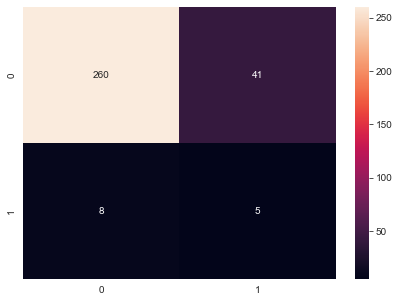

In [111]:
# Classification Accuracy
print('Accuracy on Training data:',model.score(X_train, y_train))
print('Accuracy on Test data:',model.score(X_test, y_test))

# Classification Report
print("Classification Report:\n",classification_report(y_test, model_pred))

# Confusion Matrix
print("Confusion Matrix Chart:")
cm = confusion_matrix(y_test, model_pred, labels=[0, 1])
df_cm = pd.DataFrame(cm, index = [i for i in ["0","1"]],
                  columns = [i for i in ["0","1"]])
plt.figure(figsize = (7,5))
sns.heatmap(df_cm, annot=True, fmt='g')
plt.show()

**Evaluation metrics allow us to estimate errors to determine how well our models
are performing:**

> Accuracy: ratio of correct predictions over total predictions.

> Precision: how often the classifier is correct when it predicts positive.

> Recall: how often the classifier is correct for all positive instances.

> F-Score: single measurement to combine precision and recall.

**Considering the Class Recall as the most important parameter to decide the best model for this problem. We have the highest Recall value here:**
- Class 0 predicted correctly for 86% of time. On similar lines for class 1 its 38%.
- Using F1 Score: Precision and Recall is balanced for class 0 by 91% and for class 1 by 17%.
- Precision, Recall, and F1 Score are highest for class 0 followed by class 1.
- We have maximum F1 score for class 0, and minimum for class 1.

### 6C. Pickle the selected model for future use.

In [112]:
# Import pickle Package
import pickle

In [113]:
# Save the ML model to a file in the current working directory
Pkl_Filename = "Pickle_GaussianNB_Model.pkl"  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(model, file)

In [114]:
# Load the ML Model back from the file
with open(Pkl_Filename, 'rb') as file:  
    Pickle_GaussianNB_Model = pickle.load(file)
    
Pickle_GaussianNB_Model

GaussianNB()

### 6D. Write your conclusion on the results.

- We have tried multiple models Logistic Regression, KNN, GaussianNB, SVM, Random Forest, Bagging Classifier, AdaBoost Classifier, GB Classifier, XGB Classifier, LGBM Classifier, CatBoost Classifier.
- Across methods GaussianNB performed the best while LGBM performed the worst.
- We have tried four sampling techniques: SMOTE, Random Oversampling, Random Undersampling, and ADASYN. SMOTE performed better compared to others.
- Different scaling methods like RobustScaler, MinMaxScaler, StandardScaler, Zscore were considered for model building.
- We saw that for imbalanced classes accuracy and recall are inversely proportional to each other. Better recall models have lower accuracy and vice versa.
- K-fold cross validation was used to compare various models.
- As far as PCA is considered, the models does better without it.
- Intervention of SME is vital to make sense of the dataset and various performance metrics.

## 7. 4D. Check if the train and test data have similar statistical characteristics when compared with original data
First covering: How (dis)similar are my train and test data?

In [115]:
# Split the data for training and testing
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

In [116]:
# loading test and train data
train = X_train
test = X_test

In [117]:
# adding a column to identify whether a row comes from train or not
train['is_train'] = 1
test['is_train'] = 0

In [118]:
# combining test and train data
df_combine = pd.concat([train, test], axis=0, ignore_index=True)
# dropping ‘target’ column as it is not present in the test
# df_combine = df_combine.drop(‘target’, axis =1)
y = df_combine['is_train'].values #labels
x = df_combine.drop('is_train', axis=1).values #covariates or our independent variables
tst, trn = test.values, train.values

In [119]:
m = RandomForestClassifier(n_jobs=2, max_depth=5, min_samples_leaf = 5)
predictions = np.zeros(y.shape) #creating an empty prediction array

In [120]:
from sklearn.model_selection import StratifiedKFold as SKF
from sklearn.metrics import roc_auc_score as AUC
skf = SKF(n_splits=20, shuffle=True, random_state=100)
for fold, (train_idx, test_idx) in enumerate(skf.split(x, y)):
 X_train, X_test = x[train_idx], x[test_idx]
 y_train, y_test = y[train_idx], y[test_idx]
 
 m.fit(X_train, y_train)
 probs = m.predict_proba(X_test)[:, 1] #calculating the probability
 predictions[test_idx] = probs

In [121]:
print('ROC-AUC for train and test distributions:', AUC(y, predictions))

ROC-AUC for train and test distributions: 0.5048596743611511


A high AUROC means that the model is performing well, and in this case it means that there is a big difference in distributions of predictor variables between the training and test set. Ideally, the distribution of the predictors for the training and test set should be the same, so you would want to get an AUROC that is close to 0.5.

I think this situation would only be relevant in cases where you have your model deployed and you need to check if your model is still relevant over time. If you are building a new model you shouldn’t need to do something like this because the test data is randomly sampled from the dataset. Additionally, if you’re doing cross validation then there is even less reason to worry about something like that.

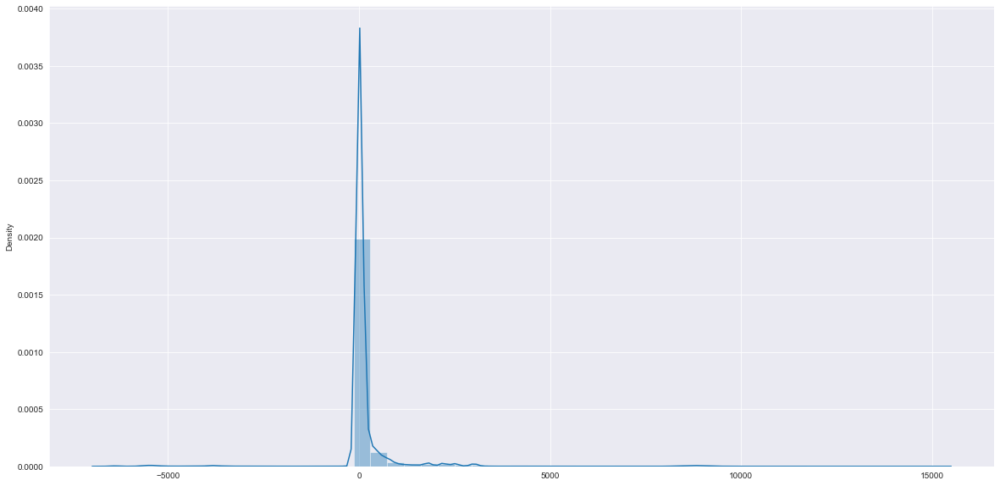

In [122]:
# Consider the distibution complete dataset X
plt.figure(figsize=(20,10))
sns.distplot(X);
plt.show()

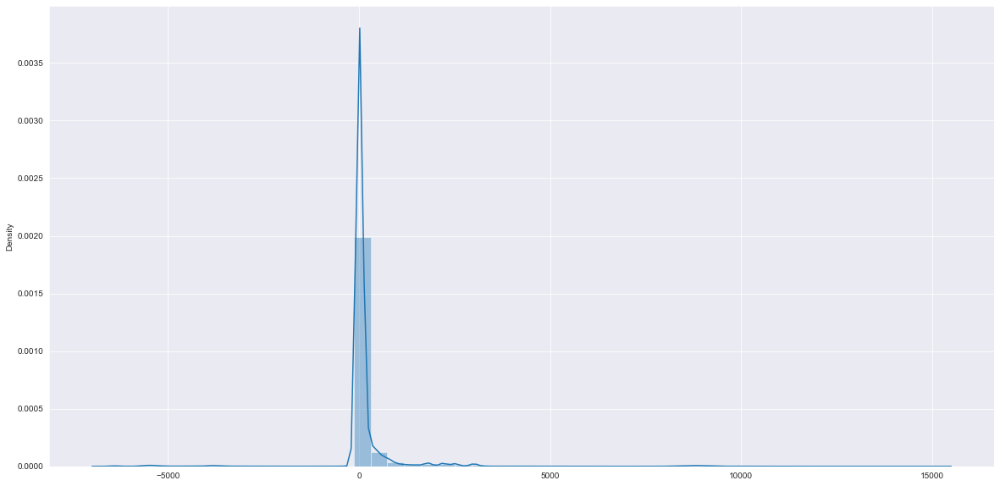

In [123]:
# Consider the distibution complete dataset X_train
plt.figure(figsize=(20,10))
sns.distplot(X_train);
plt.show()

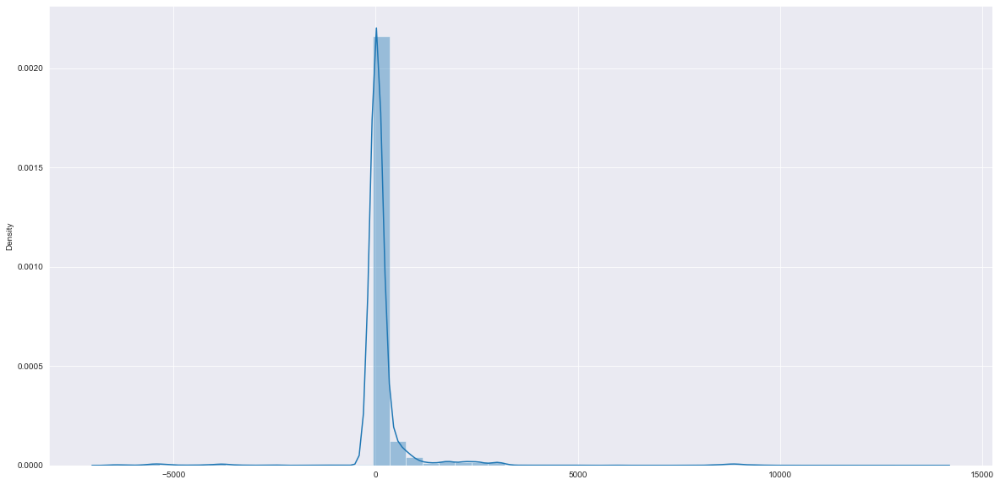

In [124]:
# Consider the distibution complete dataset X_test
plt.figure(figsize=(20,10))
sns.distplot(X_test);
plt.show()

In [125]:
# 5 Point summary for X
X.describe().T

,count,mean,std,min,25%,50%,75%,max
0,1567.0,3009.728717,62.052469,2829.8400,2968.00000,3010.9200,3051.8400,3190.9700
1,1567.0,2496.882234,60.061299,2321.4500,2459.59000,2498.9100,2534.5550,2669.0900
2,1567.0,2200.808437,26.103565,2124.8444,2182.55550,2200.9556,2217.6667,2273.7556
3,1567.0,1344.571039,334.339410,711.0258,1084.37790,1283.4368,1551.6947,2347.9092
4,1567.0,1.296230,0.333273,0.6815,1.01770,1.3101,1.4905,2.2449
...,...,...,...,...,...,...,...,...
582,1567.0,0.500094,0.003241,0.4915,0.49800,0.5002,0.5023,0.5090
583,1567.0,0.013890,0.003182,0.0060,0.01160,0.0138,0.0158,0.0237
586,1567.0,0.020561,0.010201,-0.0060,0.01345,0.0205,0.0274,0.0484
587,1567.0,0.015355,0.006570,0.0000,0.01060,0.0148,0.0190,0.0345


In [126]:
# 5 Point summary for X_train
X_train_df=pd.DataFrame(X_train)
X_train_df.describe().T

,count,mean,std,min,25%,50%,75%,max
0,1489.0,3009.976017,61.924084,2829.8400,2969.5200,3010.9200,3051.3200,3190.9700
1,1489.0,2496.284117,60.215339,2321.4500,2459.0200,2498.9100,2533.9200,2669.0900
2,1489.0,2200.916856,26.130650,2124.8444,2182.6222,2200.9556,2217.8111,2273.7556
3,1489.0,1347.780207,335.581500,711.0258,1084.3779,1283.4368,1551.6947,2347.9092
4,1489.0,1.297408,0.333051,0.6815,1.0177,1.3101,1.4905,2.2449
...,...,...,...,...,...,...,...,...
179,1489.0,0.500091,0.003234,0.4915,0.4980,0.5002,0.5023,0.5090
180,1489.0,0.013922,0.003176,0.0060,0.0116,0.0138,0.0158,0.0237
181,1489.0,0.020524,0.010224,-0.0060,0.0134,0.0205,0.0274,0.0484
182,1489.0,0.015389,0.006565,0.0000,0.0106,0.0148,0.0190,0.0345


In [127]:
# 5 Point summary for X_test
X_test_df=pd.DataFrame(X_test)
X_test_df.describe().T

,count,mean,std,min,25%,50%,75%,max
0,78.0,3005.007821,64.686489,2850.3300,2950.435000,3012.48500,3057.772500,3185.6900
1,78.0,2508.300128,56.188891,2353.2100,2485.947500,2503.13000,2539.105000,2632.8800
2,78.0,2198.738745,25.658125,2130.0556,2180.700000,2200.95560,2216.341650,2260.7333
3,78.0,1283.308840,305.210599,711.0258,1045.774800,1206.50670,1533.578475,2005.8966
4,78.0,1.273728,0.338850,0.6815,1.017700,1.28950,1.401775,2.2449
...,...,...,...,...,...,...,...,...
179,78.0,0.500155,0.003386,0.4924,0.497700,0.50045,0.502500,0.5087
180,78.0,0.013269,0.003259,0.0073,0.011025,0.01315,0.014950,0.0233
181,78.0,0.021271,0.009800,0.0005,0.014725,0.02100,0.027475,0.0473
182,78.0,0.014712,0.006672,0.0048,0.009525,0.01325,0.018275,0.0326


# References:

1. [Towards Data Science](https://towardsdatascience.com)
2. [Kaggle. Kaggle Code](https://www.kaggle.com/code)
3. [KdNuggets](https://www.kdnuggets.com/)
4. [AnalyticsVidhya](https://www.analyticsvidhya.com/blog/)
5. [Wikipedia](https://en.wikipedia.org/)
6. [Numpy](https://numpy.org/)
7. [Pandas](https://pandas.pydata.org/)
8. [SciPy](https://scipy.org/)
9. [MatplotLib](https://matplotlib.org/)
10. [Seaborn](https://seaborn.pydata.org/)
11. [Python](https://www.python.org/)
12. [Plotly](https://plotly.com/)
13. [Bokeh](https://docs.bokeh.org/en/latest/)
14. [RStudio](https://www.rstudio.com/)
15. [MiniTab](https://www.minitab.com/en-us/)
16. [Anaconda](https://www.anaconda.com/)